<a href="https://colab.research.google.com/github/Umutyagizyerli/foreign-object-segmentation/blob/main/foreign_object_segmentation-full.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!pip install torch==2.0.1+cu117 torchvision==0.15.2+cu117 torchaudio==2.0.2 --index-url https://download.pytorch.org/whl/cu117


In [ ]:
# 1. Önceki sürümleri temizle
#!pip uninstall torch torchvision torchaudio detectron2 -y

# 2. PyTorch + CUDA 12.1 yükle (T4 için optimize)
!pip install torch==2.3.0 torchvision==0.18.0  --index-url https://download.pytorch.org/whl/cu121

# 3. Detectron2'yi derle
!pip install 'git+https://github.com/facebookresearch/detectron2.git@main'

Looking in indexes: https://download.pytorch.org/whl/cu121
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 781.0/781.0 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 95.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 103.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 56.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 125.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.2/1

In [ ]:
import torch
import detectron2

# PyTorch ve CUDA durumunu kontrol et
print(f"PyTorch sürümü: {torch.__version__}")
print(f"CUDA mevcut: {torch.cuda.is_available()}")

# Detectron2'nin doğru yüklendiğini kontrol et
print(f"Detectron2 sürümü: {detectron2.__version__}")


PyTorch sürümü: 2.3.0+cu121
CUDA mevcut: True
Detectron2 sürümü: 0.6


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#COCO formatındaki veri setini Detectron2'ye tanıtmak için
from detectron2.data.datasets import register_coco_instances

# Eğitim verisini kaydet
register_coco_instances("foreign_object_train", {}, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/annotations_train/train_annotations_guncel.coco.json", "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/train")


# Test verisini kaydet
register_coco_instances("foreign_object_test", {}, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/annotations_test/test_annotations_guncel.coco.json", "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/test")

# Validation verisini kaydet
register_coco_instances("foreign_object_val", {}, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/annotations_valid/valid_annotations_guncel.coco.json", "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/valid")


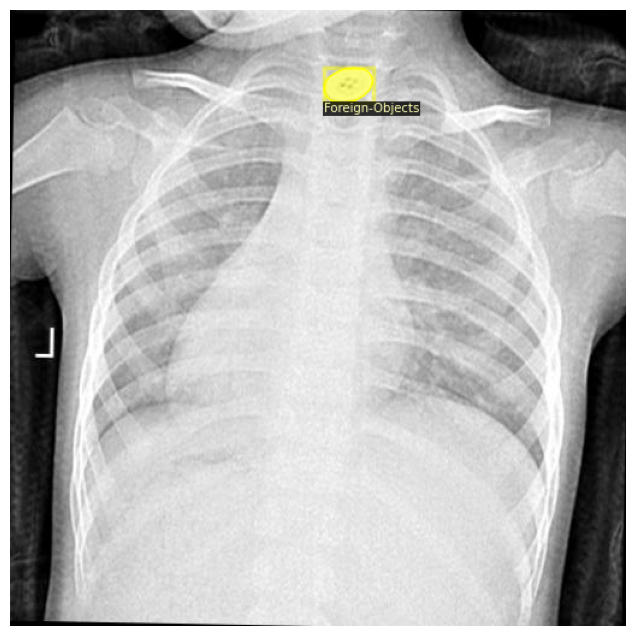

In [ ]:
#yüklemenin başarılı olup olmadığına baktık
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import random
import cv2
import matplotlib.pyplot as plt

# Örnek bir görsel göster (train setinden)
dataset_dicts = DatasetCatalog.get("foreign_object_train") #veri setindeki tüm görsel yolu,maskeler,sınıf bilgilerini getirir
metadata = MetadataCatalog.get("foreign_object_train")#veri setindeki etiket bilgisini getirir

d = random.choice(dataset_dicts)
img = cv2.imread(d["file_name"]) # file_name: rastgele seçilen görselin dosya yolu

#Visualizer rgb ile çalıştığı için görseli rgb'ye çevir
visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.0)
out = visualizer.draw_dataset_dict(d) # anatasyonları çizer

# Matplotlib ile göster
plt.figure(figsize=(12, 8))
plt.imshow(out.get_image()[:, :, ::-1]) # rgb'den bgr'ye çevirme
plt.axis("off")
plt.show()


In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo # Hazır model konfigürasyonları için
import os

cfg = get_cfg() # Detectron2 yapılandırması için,eğitim ve modelle ilgili tüm ayarlar burada yapılacak

# Mask R-CNN yapılandırmasını kullan (Mask R-CNN + ResNet-50 backbone, FPN. 3x coco modeli)
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

# Eğitim veri seti
cfg.DATASETS.TRAIN = ("foreign_object_train",)
# Test sırasında doğrulama setini kullanılacak
cfg.DATASETS.TEST = ("foreign_object_val",)

cfg.DATALOADER.NUM_WORKERS = 2 # veri yüklemesinde 2 thread kullandık

# Başlangıç model ağırlıkları (COCO ön eğitimli)
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

cfg.SOLVER.IMS_PER_BATCH = 2 # her adımda 2 görsel işlenecek (batch size)
cfg.SOLVER.BASE_LR = 0.00025  # öğrenme oranı
cfg.SOLVER.MAX_ITER = 1000    # kaç iterasyon eğitileceği, detectron2'de direkt olarak epoch kullanılmaz
cfg.SOLVER.STEPS = []         # LR düşürme adımı yok
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128  # her bir görselden alınacak örnek sayısı,maskeleri nasıl eğitileceği belirlenir(512'yi de dene)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # sınıf sayısı (yabancı cisim)

# Eğitim çıktıları buraya kaydedilecek
model_name="model_1"
## 3. Çıktı dizini Google Drive içinde olsun
output_dir = f"/content/drive/MyDrive/detectron2_outputs/{model_name}"

# 4. Klasör yoksa oluştur
os.makedirs(output_dir, exist_ok=True)

# 5. Detectron2 config çıktısını buraya yönlendir
cfg.OUTPUT_DIR = output_dir


In [ ]:
from detectron2.engine import DefaultTrainer

trainer = DefaultTrainer(cfg) # modeli oluştur,dataseti yükle,eğitimi başlat ve takip et
trainer.resume_or_load(resume=False) #eğitim sıfırdan başlar
trainer.train()


[05/27 20:10:55 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[05/27 20:10:56 d2.engine.train_loop]: Starting training from iteration 0
[05/27 20:11:03 d2.utils.events]:  eta: 0:06:04  iter: 19  total_loss: 1.929  loss_cls: 0.5913  loss_box_reg: 0.3214  loss_mask: 0.6941  loss_rpn_cls: 0.2574  loss_rpn_loc: 0.01715    time: 0.3665  last_time: 0.3507  data_time: 0.0228  last_data_time: 0.0061   lr: 4.9953e-06  max_mem: 1770M
[05/27 20:11:10 d2.utils.events]:  eta: 0:05:34  iter: 39  total_loss: 2.061  loss_cls: 0.5357  loss_box_reg: 0.3427  loss_mask: 0.6902  loss_rpn_cls: 0.3851  loss_rpn_loc: 0.03062    time: 0.3525  last_time: 0.3483  data_time: 0.0056  last_data_time: 0.0146   lr: 9.9902e-06  max_mem: 1770M
[05/27 20:11:17 d2.utils.events]:  eta: 0:05:28  iter: 59  total_loss: 1.88  loss_cls: 0.4631  loss_box_reg: 0.349  loss_mask: 0.6815  loss_rpn_cls: 0.3575  loss_rpn_loc: 0.03459    time: 0.3551  last_time: 0.3514  data_time: 0.0084  last_data_time: 0.0050   lr: 1.4985e-05  max_mem: 1770M
[05/27 20:11:24 d2.utils.events]:  eta: 0:05:22  ite

**LOSS GRAFİĞİNİN FONKSİYON HALİ**





In [ ]:
import json
import matplotlib.pyplot as plt

def plot_detectron2_loss(log_file_path, show_mask_loss=True):
    total_loss_list = []
    mask_loss_list = []

    try:
        with open(log_file_path, "r") as f:
            for line in f:
                try:
                    data = json.loads(line)
                    if "total_loss" in data:
                        total_loss_list.append(data["total_loss"])
                    if show_mask_loss and "loss_mask" in data:
                        mask_loss_list.append(data["loss_mask"])
                except json.JSONDecodeError:
                    continue

        plt.figure(figsize=(6, 4))
        plt.plot(total_loss_list, label="Total Loss", color="red")
        if show_mask_loss and mask_loss_list:
            plt.plot(mask_loss_list, label="Loss Mask", color="blue")
        plt.xlabel("Iteration")
        plt.ylabel("Loss")
        plt.title("Detectron2 Loss Grafiği")
        plt.legend()
        plt.grid(True)
        plt.show()




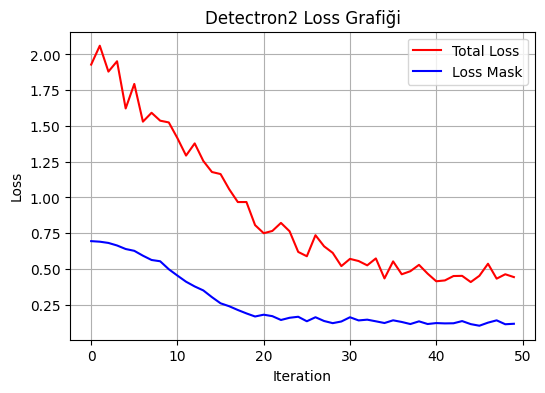

In [ ]:
plot_detectron2_loss("/content/drive/MyDrive/detectron2_outputs/model_1/metrics.json", show_mask_loss=True)


**LOSS BOX REGRESSION FONKSİYON HALİ**

In [ ]:
import json
import matplotlib.pyplot as plt

def plot_loss_box_reg(log_file_path):
    loss_box_reg_list = []

    try:
        with open(log_file_path, "r") as f:
            for line in f:
                try:
                    data = json.loads(line)
                    if "loss_box_reg" in data:
                        loss_box_reg_list.append(data["loss_box_reg"])
                except json.JSONDecodeError:
                    continue  # JSON hatası varsa satırı atla



        plt.figure(figsize=(6, 4))
        plt.plot(loss_box_reg_list, label="Loss Box Reg", color="red")
        plt.xlabel("Iteration")
        plt.ylabel("Loss Box Reg")
        plt.title("Loss Box Regression Loss Grafiği")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()




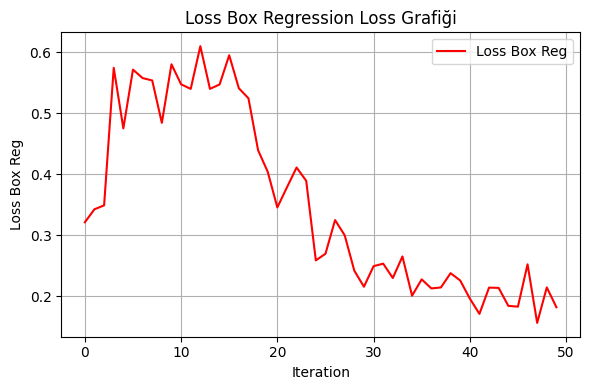

In [ ]:
plot_loss_box_reg("/content/drive/MyDrive/detectron2_outputs/model_1/metrics.json")

**RASTGELE 10 GÖRSEL FONKSİYONU**





In [ ]:
import os
import random
import cv2
import numpy as np
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from google.colab.patches import cv2_imshow

def random_predict_and_visualize(cfg, image_dir, num_samples=10, metadata_name="foreign_object_train", score_thresh=0.5):

    # Model ayarları
    cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = score_thresh
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Tek sınıf

    # Predictor oluştur
    predictor = DefaultPredictor(cfg)

    # Test klasöründeki tüm jpg dosyaları
    image_files = [f for f in os.listdir(image_dir) if f.endswith(".jpg")]

    # Rastgele seçilen görseller
    sampled_images = random.sample(image_files, min(num_samples, len(image_files)))

    for img_file in sampled_images:
        img_path = os.path.join(image_dir, img_file)
        im = cv2.imread(img_path)
        if im is None:
            print(f"Görsel yüklenemedi: {img_file}")
            continue

        # Tahmin yap
        outputs = predictor(im)

        # Görselleştir
        v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(metadata_name), scale=0.8)
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        pred_img = out.get_image()[:, :, ::-1]

        # Görselleri aynı boyuta getir
        height = min(im.shape[0], pred_img.shape[0])
        width = min(im.shape[1], pred_img.shape[1])
        im_resized = cv2.resize(im, (width, height))
        pred_resized = cv2.resize(pred_img, (width, height))

        # Yan yana birleştir
        combined = np.hstack((im_resized, pred_resized))

        print(f"Resim: {img_file}")
        cv2_imshow(combined)

[05/27 20:02:24 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_outputs/model_1/model_final.pth ...
Resim: 08405_jpg.rf.fccf81ce30199f4800f4bbc52f1f11f5.jpg


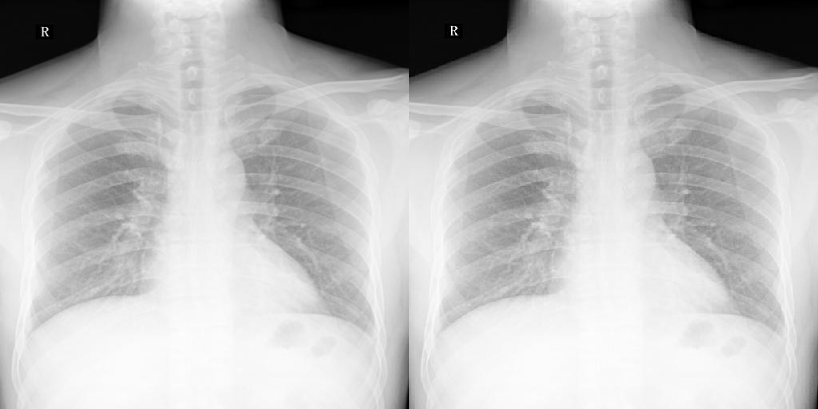

Resim: 08036_jpg.rf.994ecac617b40f9a130a63480c70859f.jpg


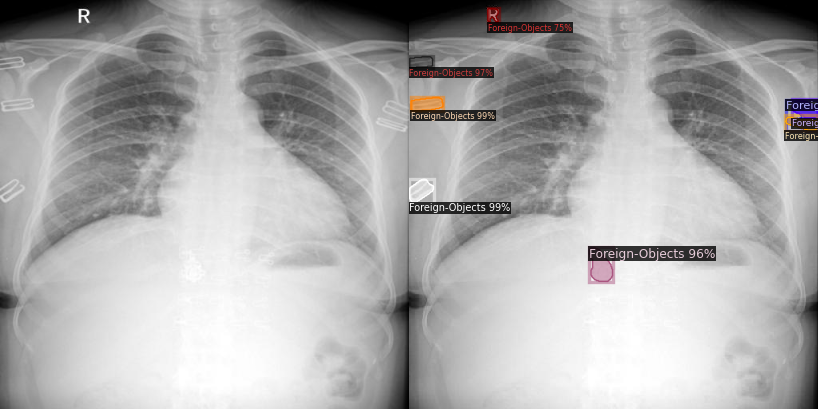

Resim: 08045_jpg.rf.fdb7a297accae6261aac7128ab07545b.jpg


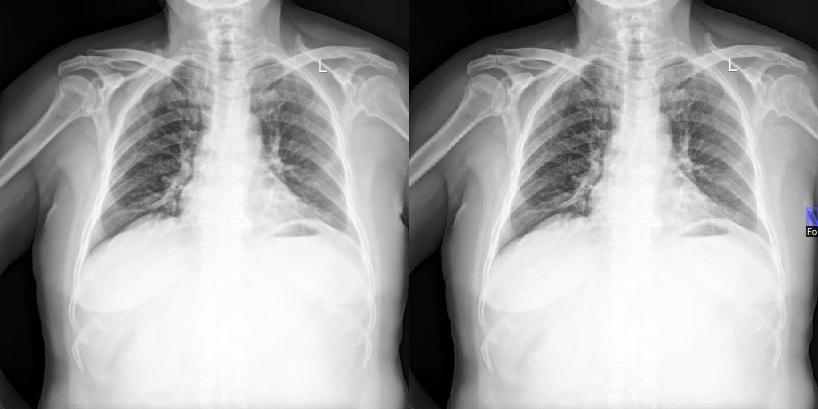

Resim: 08215_jpg.rf.31615b66323f975053c49534f863f879.jpg


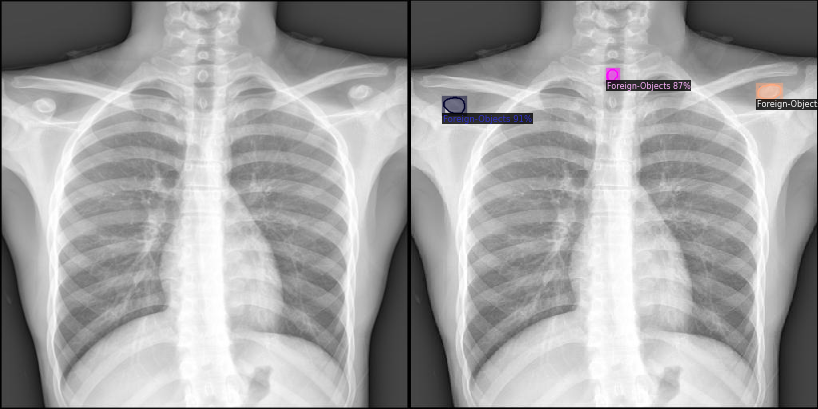

Resim: 08369_jpg.rf.d1ba5920e3b28c9718acd80bd4e5100f.jpg


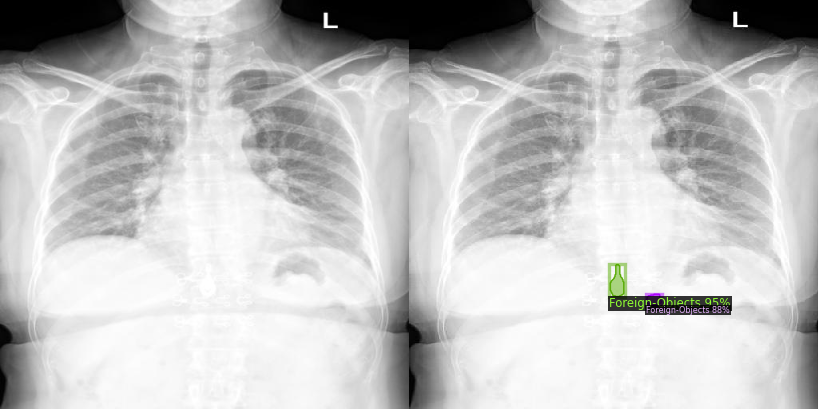

Resim: 08457_jpg.rf.184d6135eb8f8766c58d310f98ffda28.jpg


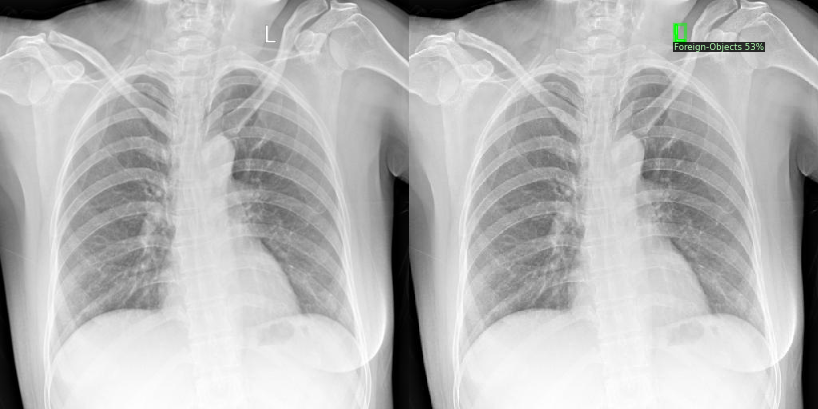

Resim: 08829_jpg.rf.eb1cb2e2ad039dcdf656def681ce48ea.jpg


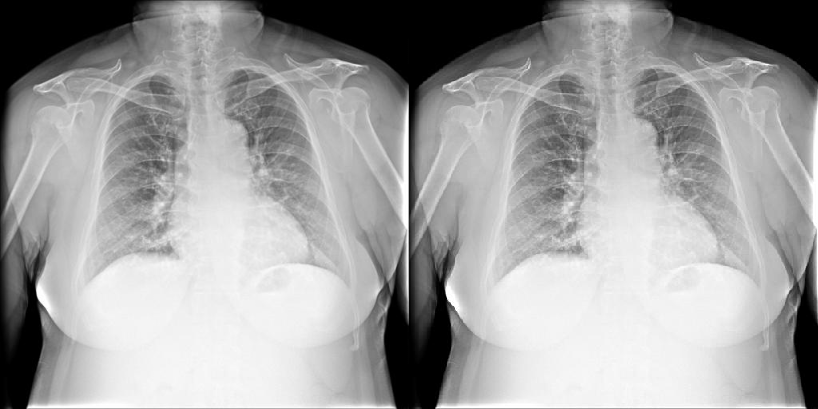

Resim: 08714_jpg.rf.91a96739dc92cc634f9abcf602477f1f.jpg


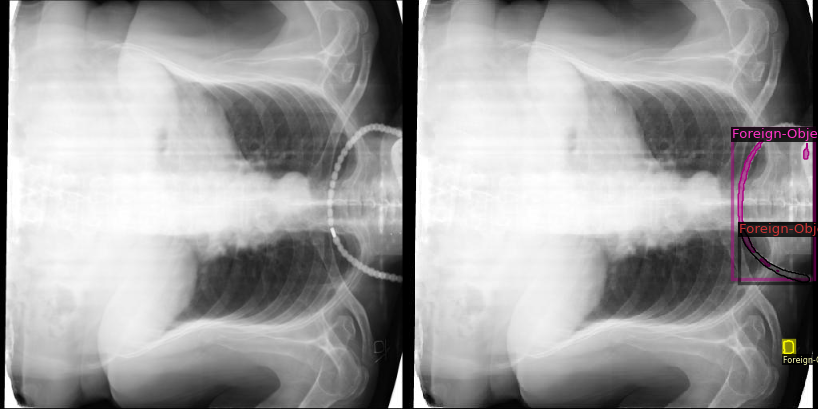

Resim: 08442_jpg.rf.59c900a14f6c08642ad1a42463adbe1a.jpg


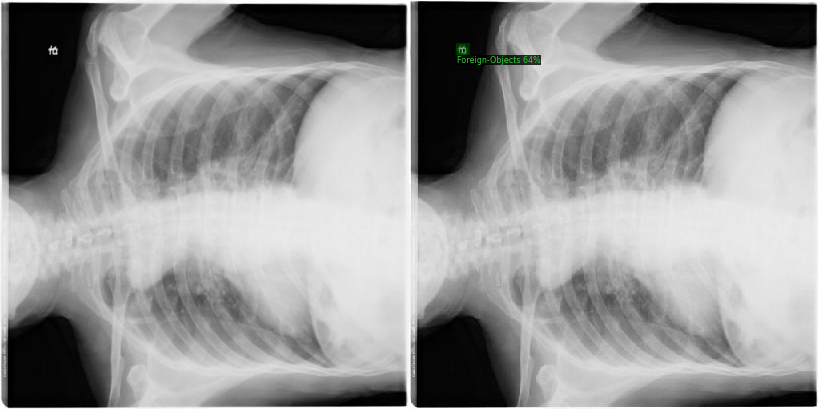

Resim: 08774_jpg.rf.7f47603e2eb6230ddd640767853956e7.jpg


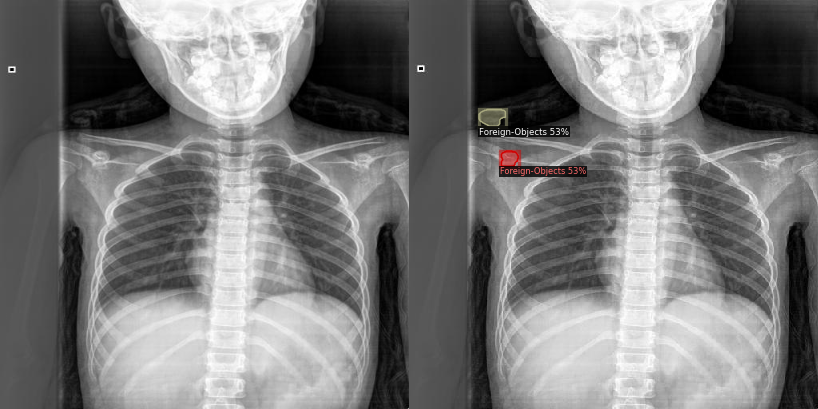

In [ ]:
random_predict_and_visualize(cfg, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/test", num_samples=10)


--------------------------------------**MODEL-2**---------------------------------




In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo # Hazır model konfigürasyonları için
import os

cfg = get_cfg() # Detectron2 yapılandırması için,eğitim ve modelle ilgili tüm ayarlar burada yapılacak

# Mask R-CNN yapılandırmasını kullan (Mask R-CNN + ResNet-101 backbone, FPN. 3x coco modeli)
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))

# Eğitim veri seti
cfg.DATASETS.TRAIN = ("foreign_object_train",)
# Test sırasında doğrulama setini kullanmak istiyoruz
cfg.DATASETS.TEST = ("foreign_object_val",)

cfg.DATALOADER.NUM_WORKERS = 2 # veri yüklemesinde 2 thread kullandık

# Başlangıç model ağırlıkları (COCO ön eğitimli)
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")

cfg.SOLVER.IMS_PER_BATCH = 2 # her adımda 2 görsel işlenecek (batch size)
cfg.SOLVER.BASE_LR = 0.00025  # öğrenme oranı
cfg.SOLVER.MAX_ITER = 1000    # kaç iterasyon eğitileceği, detectron2'de direkt olarak epoch kullanılmaz
cfg.SOLVER.STEPS = []         # LR düşürme adımı yok
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128  # her bir görselden alınacak örnek sayısı,maskeleri nasıl eğitileceği belirlenir(512'yi de dene)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # sınıf sayısı (yabancı cisim)

model_name="model_2"
## 3. Çıktı dizini Google Drive içinde olsun
output_dir = f"/content/drive/MyDrive/detectron2_outputs/{model_name}"

# 4. Klasör yoksa oluştur
os.makedirs(output_dir, exist_ok=True)

# 5. Detectron2 config çıktısını buraya yönlendir
cfg.OUTPUT_DIR = output_dir


In [ ]:
from detectron2.engine import DefaultTrainer

trainer = DefaultTrainer(cfg) # modeli oluştur,dataseti yükle,eğitimi başlat ve takip et
trainer.resume_or_load(resume=False) #eğitim sıfırdan başlar
trainer.train()


[05/27 20:18:20 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:01, 129MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[05/27 20:18:22 d2.engine.train_loop]: Starting training from iteration 0
[05/27 20:18:32 d2.utils.events]:  eta: 0:08:01  iter: 19  total_loss: 1.977  loss_cls: 0.4968  loss_box_reg: 0.2918  loss_mask: 0.693  loss_rpn_cls: 0.3955  loss_rpn_loc: 0.02502    time: 0.5026  last_time: 0.5327  data_time: 0.0161  last_data_time: 0.0268   lr: 4.9953e-06  max_mem: 2412M
[05/27 20:18:43 d2.utils.events]:  eta: 0:08:25  iter: 39  total_loss: 1.9  loss_cls: 0.4763  loss_box_reg: 0.3436  loss_mask: 0.6887  loss_rpn_cls: 0.3471  loss_rpn_loc: 0.03418    time: 0.5257  last_time: 0.4834  data_time: 0.0058  last_data_time: 0.0061   lr: 9.9902e-06  max_mem: 2412M
[05/27 20:18:53 d2.utils.events]:  eta: 0:07:53  iter: 59  total_loss: 1.926  loss_cls: 0.4476  loss_box_reg: 0.4179  loss_mask: 0.679  loss_rpn_cls: 0.3983  loss_rpn_loc: 0.03655    time: 0.5137  last_time: 0.4194  data_time: 0.0067  last_data_time: 0.0052   lr: 1.4985e-05  max_mem: 2412M
[05/27 20:19:03 d2.utils.events]:  eta: 0:07:40  iter:

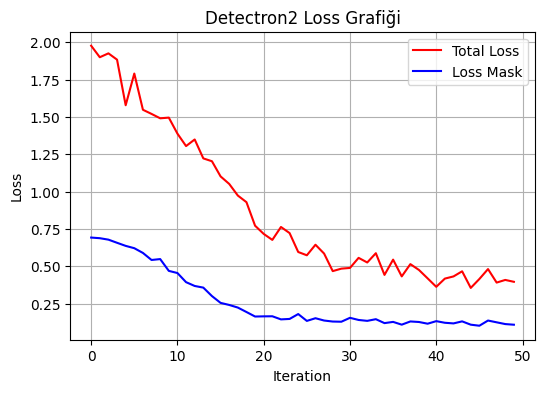

In [ ]:
plot_detectron2_loss("/content/drive/MyDrive/detectron2_outputs/model_2/metrics.json", show_mask_loss=True)

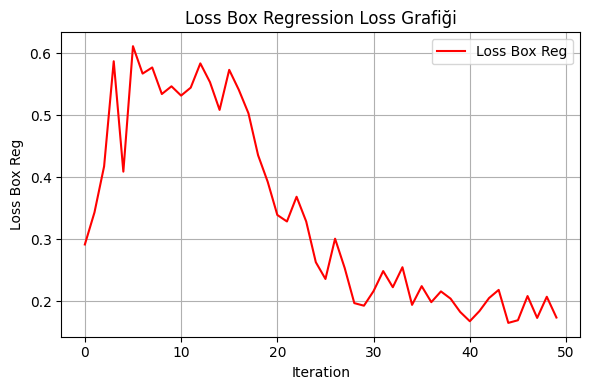

In [ ]:
plot_loss_box_reg("/content/drive/MyDrive/detectron2_outputs/model_2/metrics.json")

[05/27 20:33:45 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_outputs/model_2/model_final.pth ...
Resim: 08738_jpg.rf.51df231a65f7d15fac3a1fb23aac7679.jpg


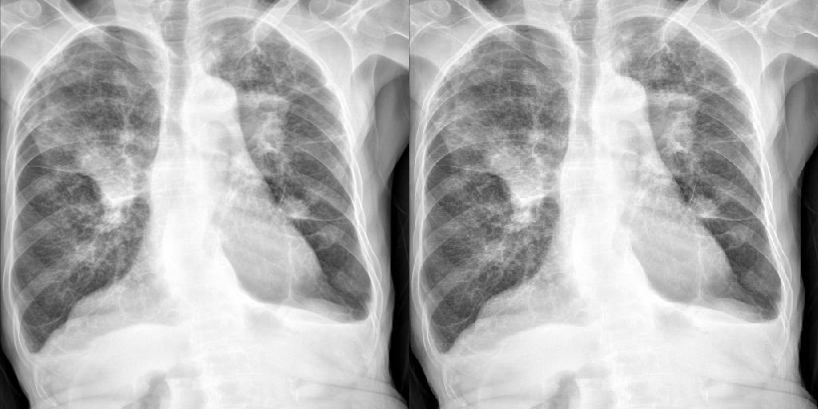

Resim: 08318_jpg.rf.537d783816ab8f98250cc6a2ad92ca18.jpg


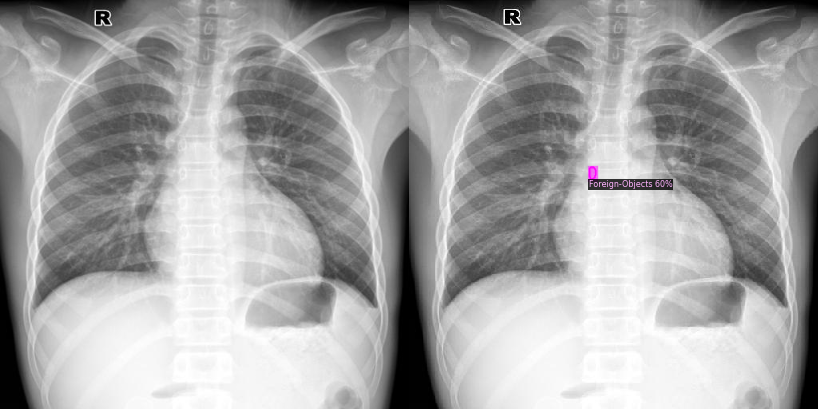

Resim: 08046_jpg.rf.c3763dc732c90895389fb727fff4a607.jpg


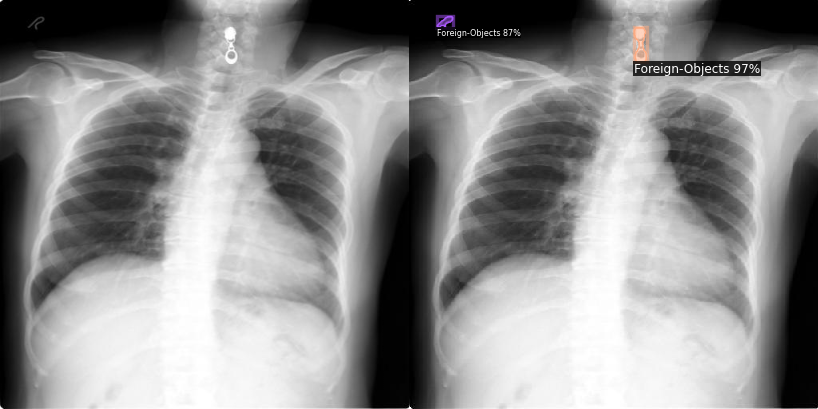

Resim: 08601_jpg.rf.4f7c08a4d367f7f2b1cd5368351bf3b8.jpg


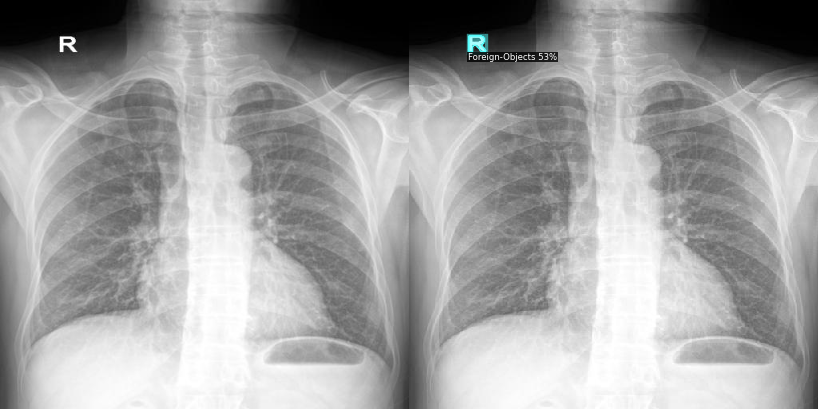

Resim: 08177_jpg.rf.0173f89ecc6aca23f284fc4f41d5b5b1.jpg


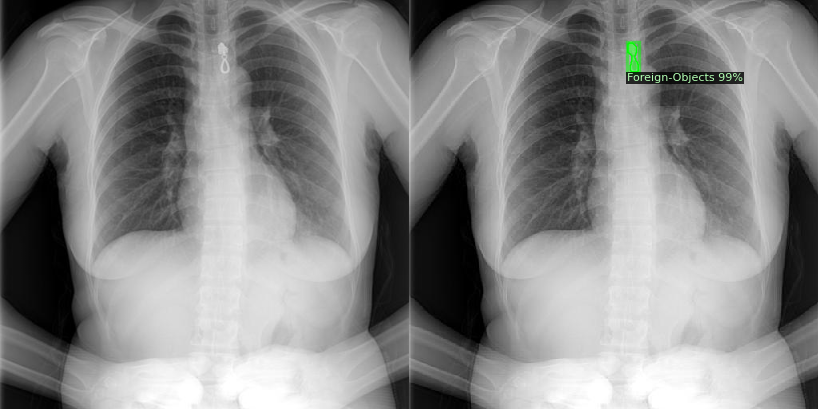

Resim: 08829_jpg.rf.eb1cb2e2ad039dcdf656def681ce48ea.jpg


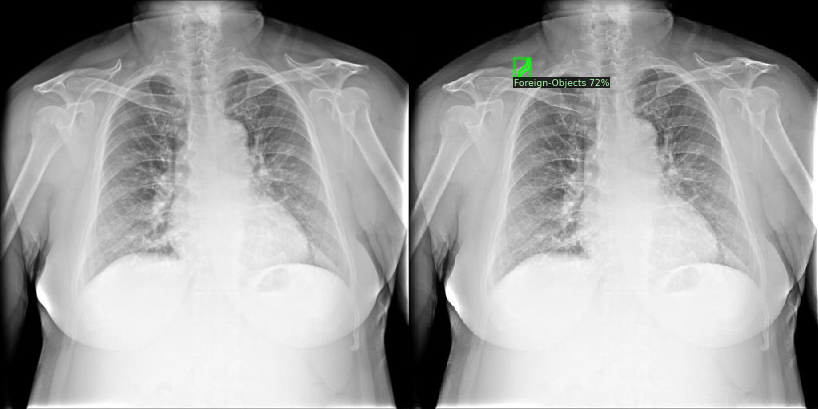

Resim: 08118_jpg.rf.e3e79721a112289426ea5353f1e0ff16.jpg


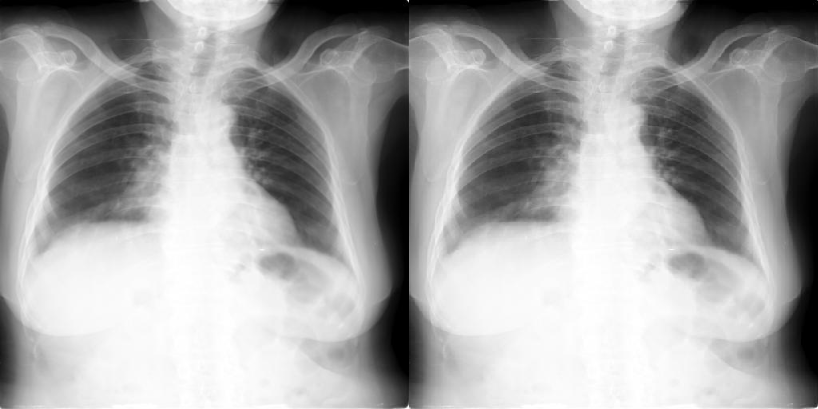

Resim: 08968_jpg.rf.d8142bfca4206af6ea70c030dc376790.jpg


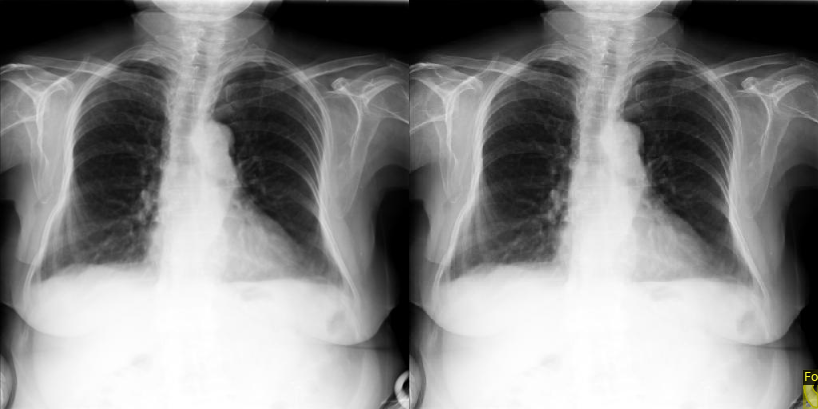

Resim: 08098_jpg.rf.492aea8e664291704c1f5a4bcc1694b7.jpg


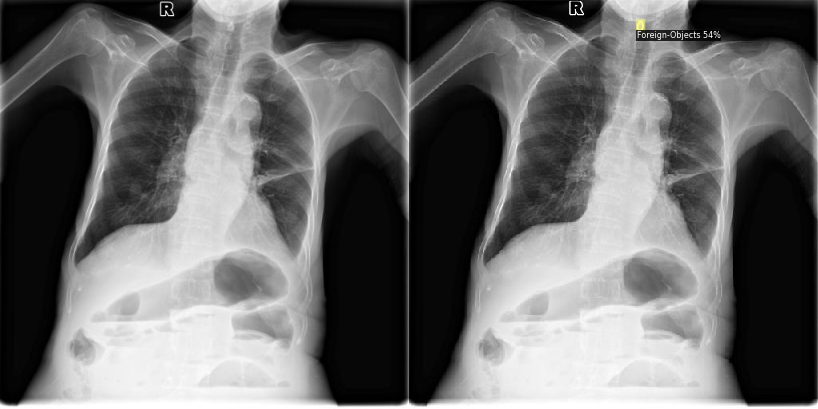

Resim: 08455_jpg.rf.e6f95b052b00767111ef92f367d3ca6a.jpg


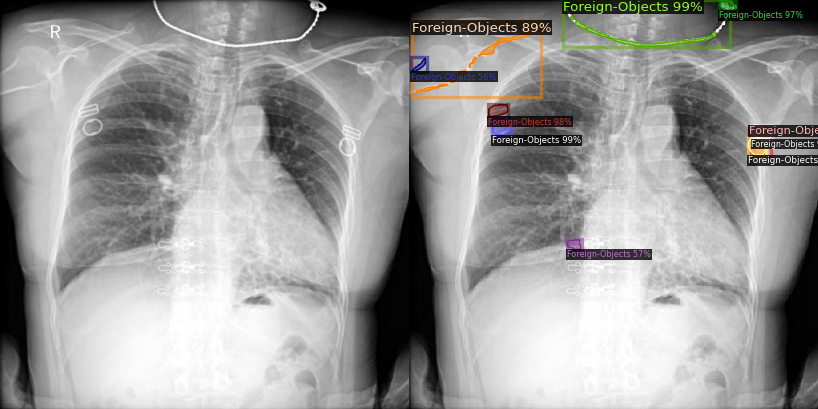

In [ ]:
random_predict_and_visualize(cfg, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/test", num_samples=10)


**MODEL-3**

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo # Hazır model konfigürasyonları için
import os

cfg = get_cfg() # Detectron2 yapılandırması için,eğitim ve modelle ilgili tüm ayarlar burada yapılacak

# Mask R-CNN yapılandırmasını kullan (Mask R-CNN + ResNet-101 backbone, FPN. 3x coco modeli)
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))

# Eğitim veri seti
cfg.DATASETS.TRAIN = ("foreign_object_train",)
cfg.DATASETS.TEST = ("foreign_object_val",)

cfg.DATALOADER.NUM_WORKERS = 2 # veri yüklemesinde 2 thread kullandık

# Başlangıç model ağırlıkları (COCO ön eğitimli)
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")

cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.00001  # öğrenme oranı
cfg.SOLVER.MAX_ITER = 1000    # kaç iterasyon eğitileceği
cfg.SOLVER.STEPS = (700,900)
cfg.SOLVER.GAMMA=0.1
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  # her bir görselden alınacak örnek sayısı,maskeleri nasıl eğitileceği belirlenir(512'yi de dene)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # sınıf sayısı (yabancı cisim)

model_name="model_3"
## 3. Çıktı dizini Google Drive içinde olsun
output_dir = f"/content/drive/MyDrive/detectron2_outputs/{model_name}"

# 4. Klasör yoksa oluştur
os.makedirs(output_dir, exist_ok=True)

# 5. Detectron2 config çıktısını buraya yönlendir
cfg.OUTPUT_DIR = output_dir


In [ ]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/27 20:40:23 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[05/27 20:40:23 d2.engine.train_loop]: Starting training from iteration 0
[05/27 20:40:45 d2.utils.events]:  eta: 0:17:06  iter: 19  total_loss: 2.142  loss_cls: 0.8515  loss_box_reg: 0.1655  loss_mask: 0.6943  loss_rpn_cls: 0.4169  loss_rpn_loc: 0.02738    time: 1.0837  last_time: 0.9912  data_time: 0.0304  last_data_time: 0.0234   lr: 1.171e-08  max_mem: 4236M
[05/27 20:41:07 d2.utils.events]:  eta: 0:17:17  iter: 39  total_loss: 2.391  loss_cls: 0.8486  loss_box_reg: 0.1861  loss_mask: 0.6942  loss_rpn_cls: 0.5976  loss_rpn_loc: 0.04261    time: 1.0881  last_time: 0.9577  data_time: 0.0156  last_data_time: 0.0104   lr: 1.351e-08  max_mem: 4236M
[05/27 20:41:27 d2.utils.events]:  eta: 0:16:49  iter: 59  total_loss: 2.125  loss_cls: 0.8462  loss_box_reg: 0.2024  loss_mask: 0.6945  loss_rpn_cls: 0.357  loss_rpn_loc: 0.02797    time: 1.0637  last_time: 1.0889  data_time: 0.0201  last_data_time: 0.0226   lr: 1.531e-08  max_mem: 4236M
[05/27 20:41:48 d2.utils.events]:  eta: 0:16:27  iter:

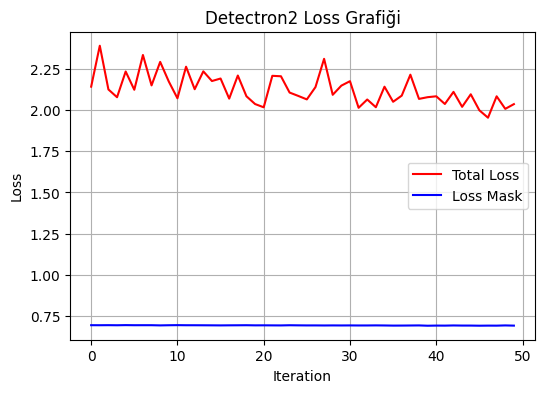

In [ ]:
plot_detectron2_loss("/content/drive/MyDrive/detectron2_outputs/model_3/metrics.json", show_mask_loss=True)

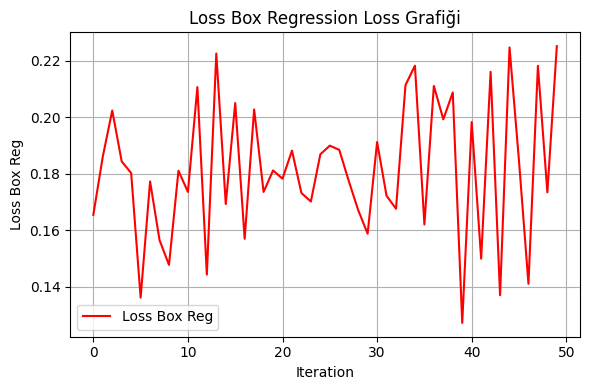

In [ ]:
plot_loss_box_reg("/content/drive/MyDrive/detectron2_outputs/model_3/metrics.json")

[05/27 20:59:46 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_outputs/model_3/model_final.pth ...
Resim: 08968_jpg.rf.d8142bfca4206af6ea70c030dc376790.jpg


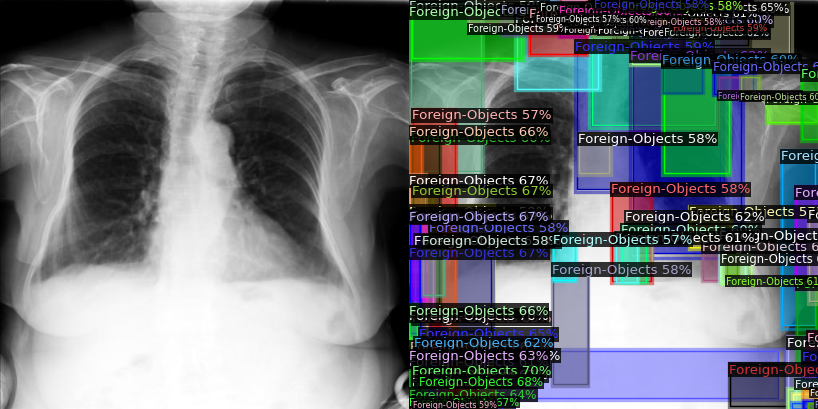

Resim: 08982_jpg.rf.44f201cc66df70e74025cae7b4c92ac0.jpg


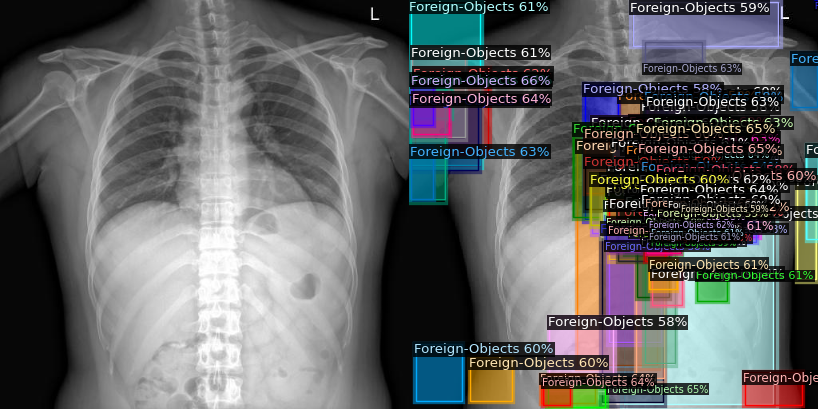

Resim: 08784_jpg.rf.26d77b144f4819f43f48779e2fbaa8f8.jpg


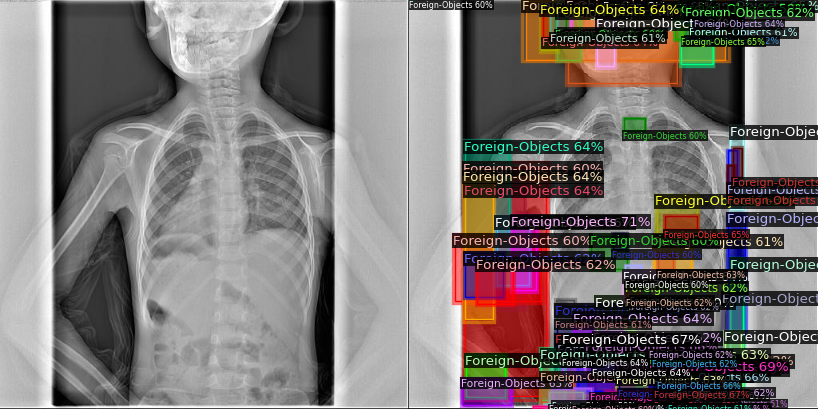

Resim: 08507_jpg.rf.2093f677f2e82935935b552bb068e207.jpg


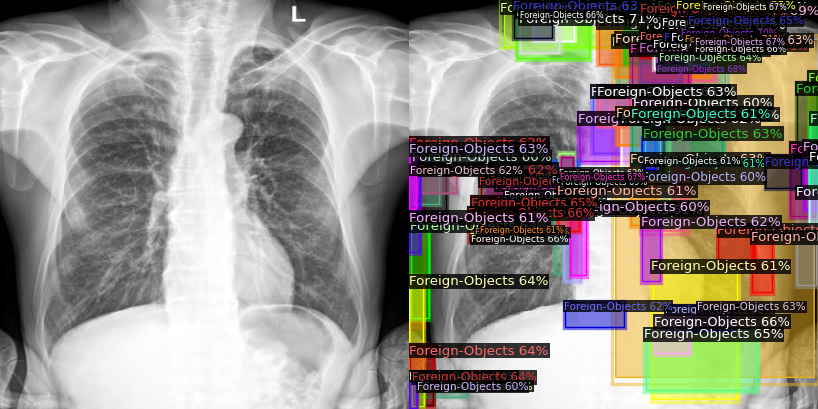

Resim: 08085_jpg.rf.05d0186887cccf248cc8e7d6cdc504ec.jpg


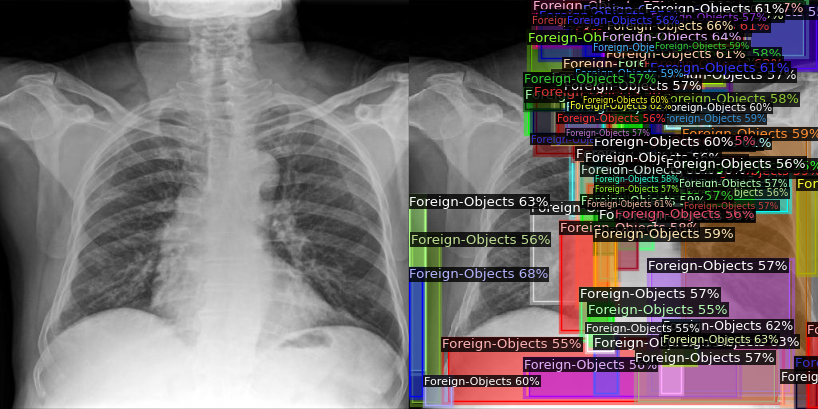

Resim: 08445_jpg.rf.be4eb59ab942c15700825fa0e0ed11e6.jpg


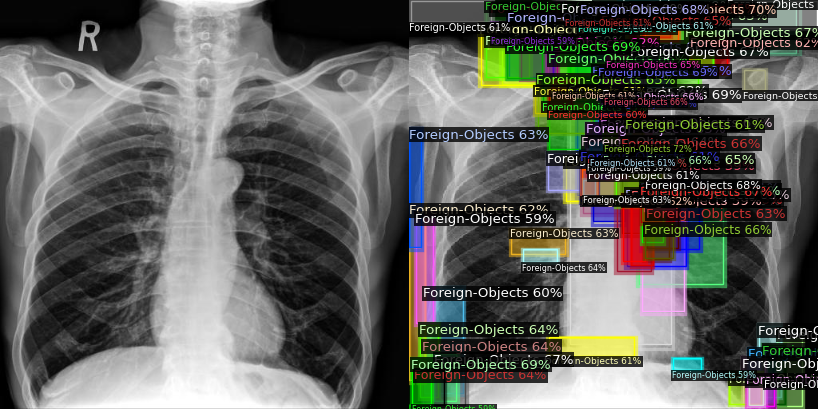

Resim: 08391_jpg.rf.eefa337c07f9b8da593288e48d808105.jpg


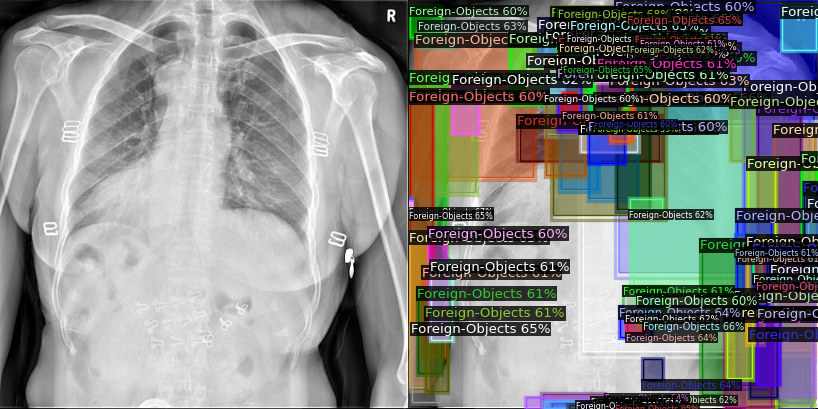

Resim: 08763_jpg.rf.e5b7e70cb17f2783d6857f9776d3414b.jpg


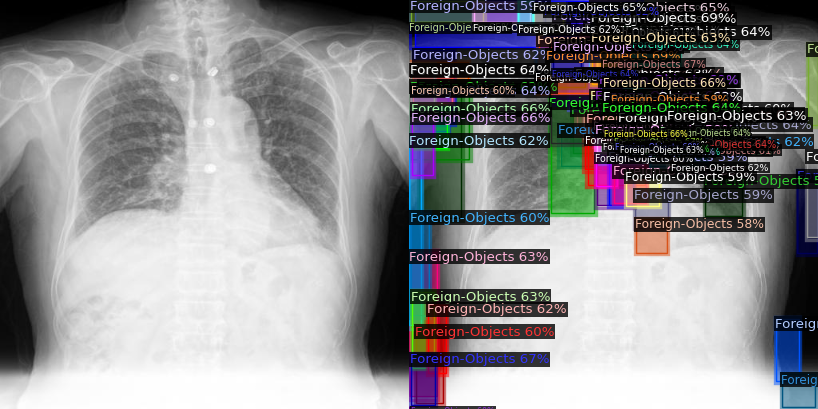

Resim: 08323_jpg.rf.b302a46e5098e2ac0fb7b14598322721.jpg


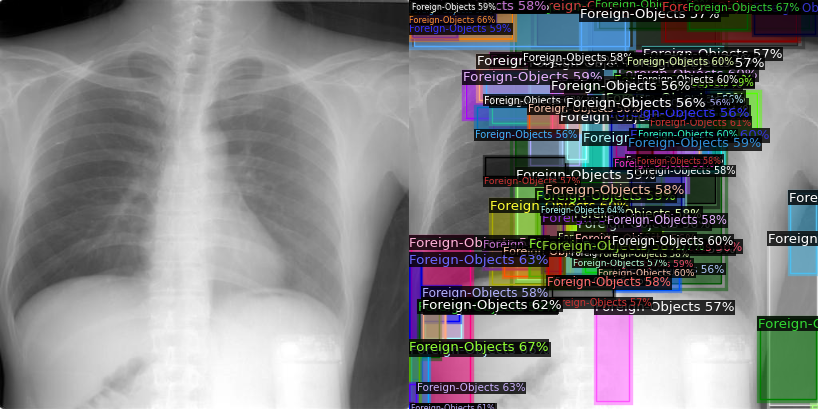

Resim: 08135_jpg.rf.3cd1b0ecea8905c95e7b9fafb67a3cdb.jpg


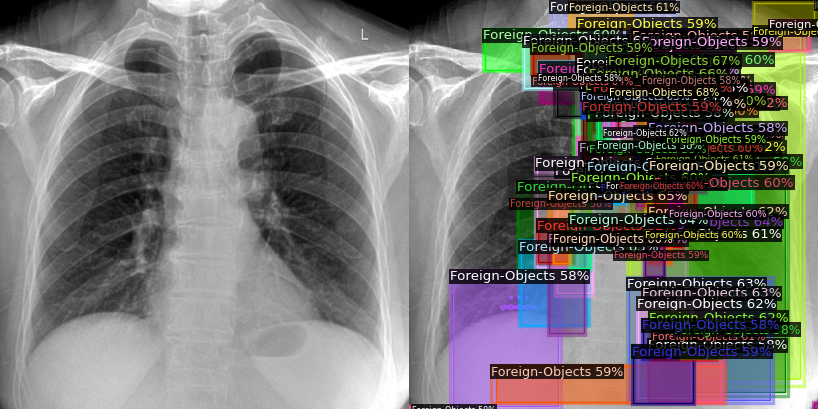

In [ ]:
random_predict_and_visualize(cfg, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/test", num_samples=10)


Farklı model

In [ ]:
import os
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.data import transforms as T

# 1. Temel Konfigürasyon
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))

# 2. Veri Ayarları
cfg.DATASETS.TRAIN = ("foreign_object_train",)
cfg.DATASETS.TEST = ("foreign_object_val",)
cfg.DATALOADER.NUM_WORKERS = 2  # GPU'ya bağlı olarak artırılabilir
cfg.INPUT.MASK_FORMAT = "bitmask"  # X-Ray'ler için optimal format

# 3. Model Ağırlıkları
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg.MODEL.PIXEL_MEAN = [123.675, 116.280, 103.530]  # COCO mean (RGB)
cfg.MODEL.PIXEL_STD = [58.395, 57.120, 57.375]  # COCO std

# 4. Sadece Maske Odaklı Eğitim (Bounding Box'ları devre dışı bırak)
cfg.MODEL.ROI_BOX_HEAD.NAME = "FastRCNNConvFCHead"
cfg.MODEL.ROI_BOX_HEAD.BBOX_REG_LOSS_TYPE = "smooth_l1"
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # "yabancı_cisim" sınıfı

# 5. Mask Optimizasyonları
cfg.MODEL.ROI_MASK_HEAD.POOLER_RESOLUTION = 14  # Daha detaylı maskeler
cfg.MODEL.ROI_MASK_HEAD.NUM_CONV = 4  # Ek konvolüsyon katmanları
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 32  # Daha fazla örnek

# 6. Optimizasyon Parametreleri
cfg.SOLVER.IMS_PER_BATCH = 2  # GPU belleğine göre ayarlayın
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 500
cfg.SOLVER.MAX_ITER = 2000
cfg.SOLVER.STEPS = [1500, 1800]  # Learning rate düşürme adımları
cfg.SOLVER.GAMMA = 0.1
cfg.SOLVER.CHECKPOINT_PERIOD = 500  # Her 500 iterasyonda bir kayıt

# 7. Gradient ve Regularization
cfg.SOLVER.CLIP_GRADIENTS.ENABLED = True
cfg.SOLVER.CLIP_GRADIENTS.CLIP_VALUE = 1.0
cfg.MODEL.BACKBONE.FREEZE_AT = 2  # İlk 2 backbone katmanını dondur

# 8. Veri Artırma (Augmentation)
"""
cfg.DATALOADER.AUG_OPS = [
    T.RandomFlip(horizontal=True, vertical=False, prob=0.5),
    T.RandomRotation(angle=[-15, 15]),
    T.RandomBrightness(0.8, 1.2),
    T.RandomContrast(0.8, 1.2),
    T.RandomCrop("relative_range", (0.8, 0.8))  # X-Ray'ler için önemli
]
"""

# 9. Değerlendirme ve Loglama
cfg.TEST.EVAL_PERIOD = 100  # Her 100 iterasyonda bir validasyon
cfg.TEST.DETECTIONS_PER_IMAGE = 50  # X-Ray'lerde genelde az nesne olur

cfg.TENSORBOARD_LOG_DIR = "./tensorboard"  # TensorBoard log dizini
os.makedirs(cfg.TENSORBOARD_LOG_DIR, exist_ok=True)

# 10. Çıktı Dizinleri
cfg.OUTPUT_DIR = "./output"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)


In [ ]:
# 12. Trainer Başlatma
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)

# 13. Eğitimi Başlat
print("Eğitim başlıyor...")
trainer.train()

[05/24 18:32:31 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:02, 124MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


Eğitim başlıyor...
[05/24 18:32:34 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/24 18:32:49 d2.utils.events]:  eta: 0:15:19  iter: 19  total_loss: 2.376  loss_cls: 0.6284  loss_box_reg: 0.08059  loss_mask: 0.6908  loss_rpn_cls: 0.6393  loss_rpn_loc: 0.07085    time: 0.4573  last_time: 0.4798  data_time: 0.1752  last_data_time: 0.0067   lr: 3.8962e-05  max_mem: 2665M
[05/24 18:33:07 d2.utils.events]:  eta: 0:14:57  iter: 39  total_loss: 1.776  loss_cls: 0.3966  loss_box_reg: 0.005322  loss_mask: 0.6823  loss_rpn_cls: 0.5801  loss_rpn_loc: 0.05349    time: 0.4512  last_time: 0.3867  data_time: 0.0074  last_data_time: 0.0090   lr: 7.8922e-05  max_mem: 2665M
[05/24 18:33:16 d2.utils.events]:  eta: 0:14:09  iter: 59  total_loss: 1.412  loss_cls: 0.3595  loss_box_reg: 0.08422  loss_mask: 0.6624  loss_rpn_cls: 0.2591  loss_rpn_loc: 0.04815    time: 0.4440  last_time: 0.4428  data_time: 0.0110  last_data_time: 0.0133   lr: 0.00011888  max_mem: 2665M
[05/24 18:33:25 d2.utils.events]:  eta: 0:14:06  iter: 79  total_loss: 1.857  loss_cls: 0.4254  loss_box_reg: 0.4165  lo

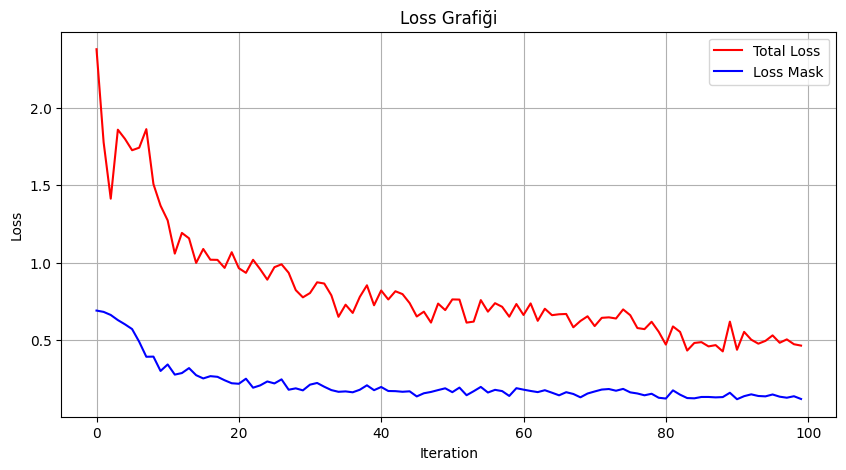

In [ ]:
import json
import matplotlib.pyplot as plt

# Log dosyasının yolu (varsayılan olarak output klasöründedir)
log_file_path = "/content/output/metrics.json"

# Değerleri saklamak için boş listeler
total_loss_list = []
mask_loss_list = []

# JSON satırlarını oku
with open(log_file_path, "r") as f:
    for line in f:
        try:
            data = json.loads(line)
            if "total_loss" in data:
                total_loss_list.append(data["total_loss"])
            if "loss_mask" in data:
                mask_loss_list.append(data["loss_mask"])
        except:
            continue  # JSON hatalarını atla

# Grafik çiz
plt.figure(figsize=(10, 5))
plt.plot(total_loss_list, label="Total Loss", color="red")
plt.plot(mask_loss_list, label="Loss Mask", color="blue")
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("Loss Grafiği")
plt.legend()
plt.grid(True)
plt.show()


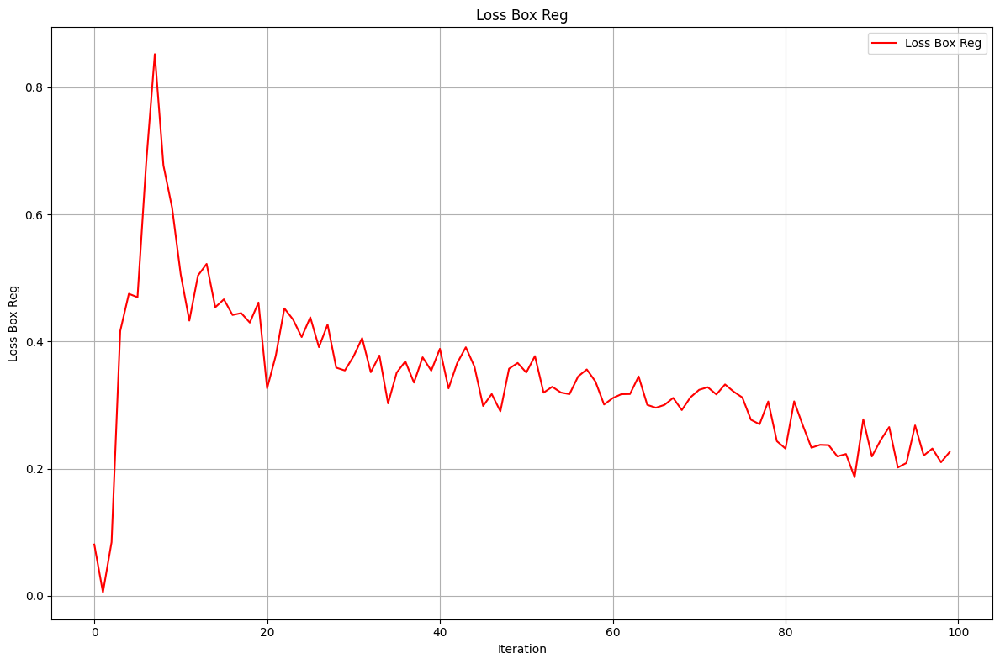

In [ ]:
import json
import matplotlib.pyplot as plt

# Log dosyasının yolu
log_file_path = "/content/output/metrics.json"

loss_box_reg_list = []

# JSON satırlarını oku
with open(log_file_path, "r") as f:
    for line in f:
        try:
            data = json.loads(line)
            if "loss_box_reg" in data:
                loss_box_reg_list.append(data["loss_box_reg"])
        except:
            continue  # JSON hatalarını atla

# Grafik çizme
plt.figure(figsize=(12, 8))

# loss_box_reg
plt.plot(loss_box_reg_list, label="Loss Box Reg", color="red")
plt.xlabel("Iteration")
plt.ylabel("Loss Box Reg")
plt.title("Loss Box Reg")
plt.legend()
plt.grid(True)

# Grafikleri göster
plt.tight_layout()
plt.show()


# modelin, nesneleri doğru boyutlarda bounding box ile tahmin oranını gösterir

[05/24 18:55:45 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/output/model_final.pth ...
Resim: 08431_jpg.rf.4ddf873514433806f52654d027279e3d.jpg


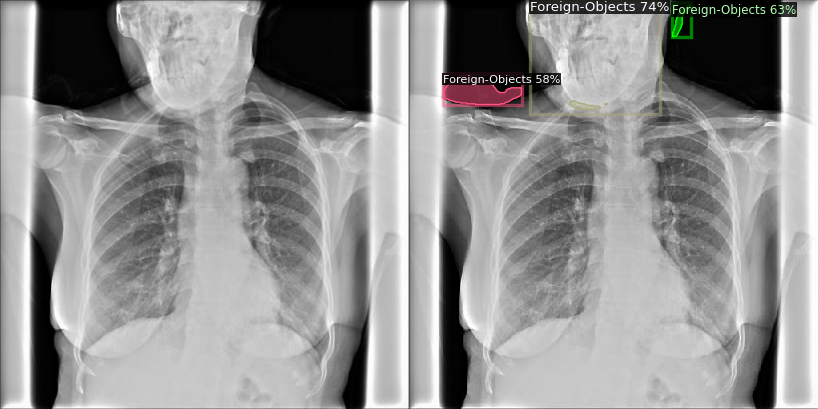

Resim: 08442_jpg.rf.59c900a14f6c08642ad1a42463adbe1a.jpg


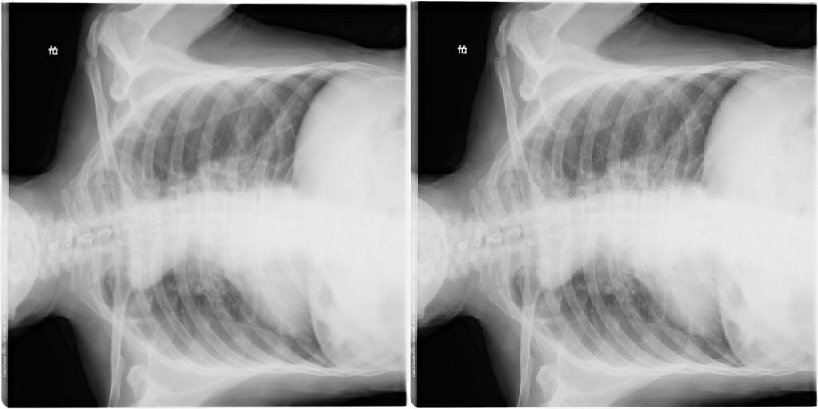

Resim: 08908_jpg.rf.bd2b2ba21286cc0d9cf87fc0e30daffb.jpg


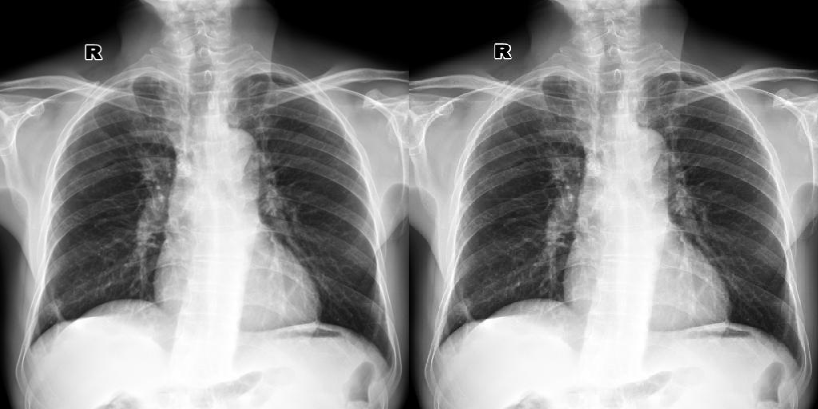

Resim: 08395_jpg.rf.94c47f232bc7fd3769d394a8721fe447.jpg


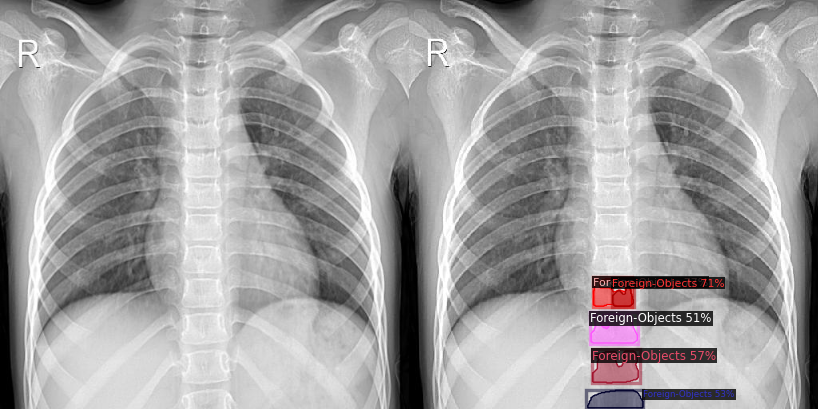

Resim: 08492_jpg.rf.5d27d2a0bf207ec357a2b6c500adaea6.jpg


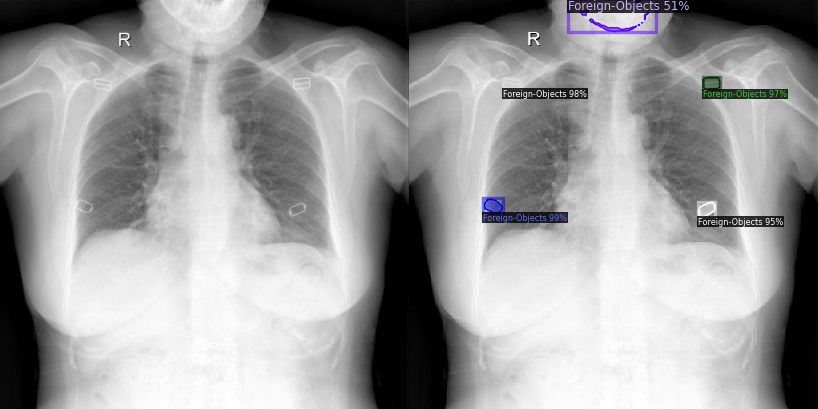

Resim: 08918_jpg.rf.77e366298e31d4ed85f927bfd534c6d6.jpg


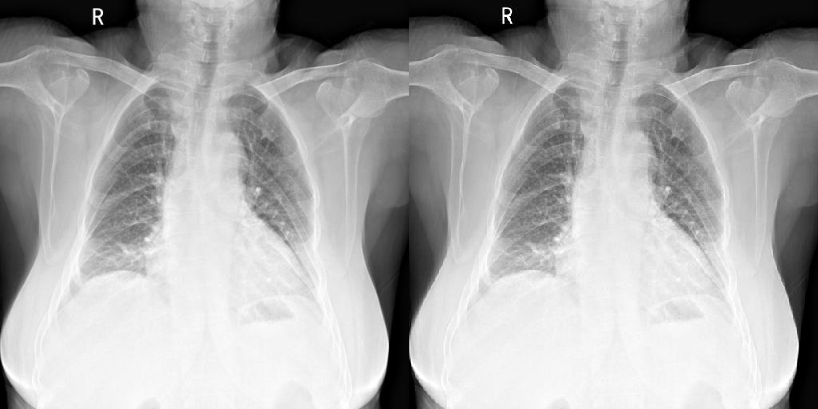

Resim: 08273_jpg.rf.cfbacc3efeb162870cfbbd5bc9bfb48e.jpg


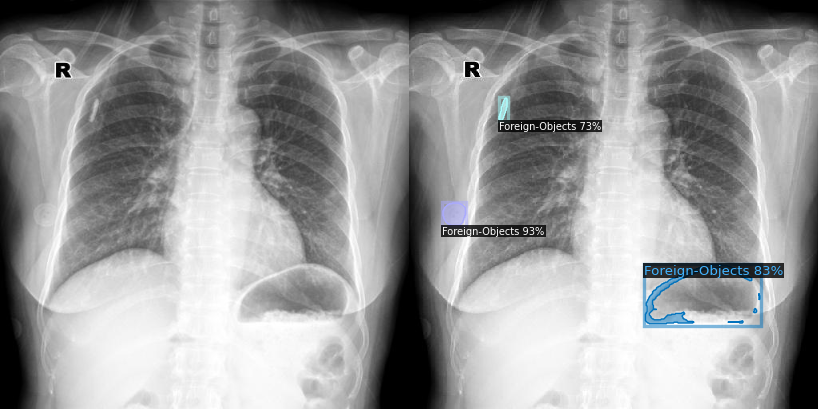

Resim: 08056_jpg.rf.9ee565bcb3a85498a847036a869e062a.jpg


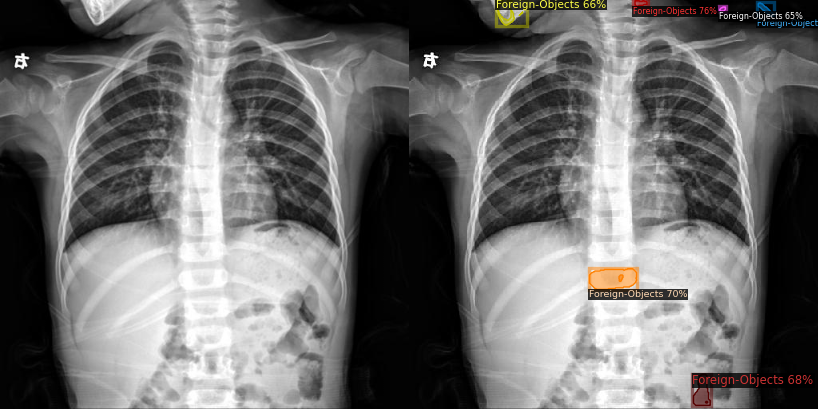

Resim: 08385_jpg.rf.221bd96f5fb1872e7d7f3aa2f00e93b8.jpg


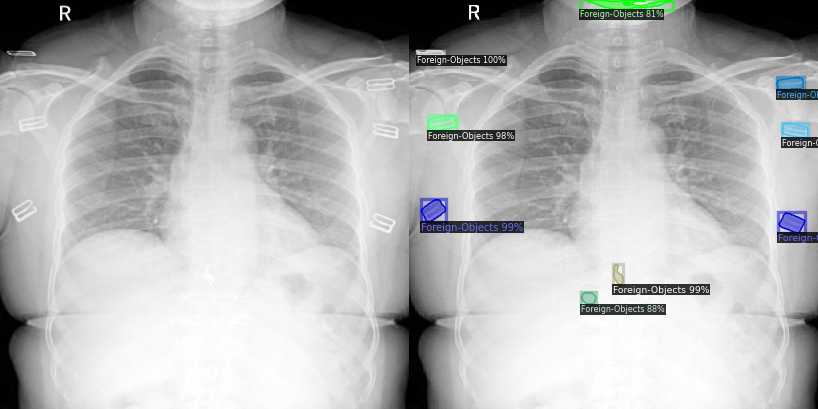

Resim: 08323_jpg.rf.b302a46e5098e2ac0fb7b14598322721.jpg


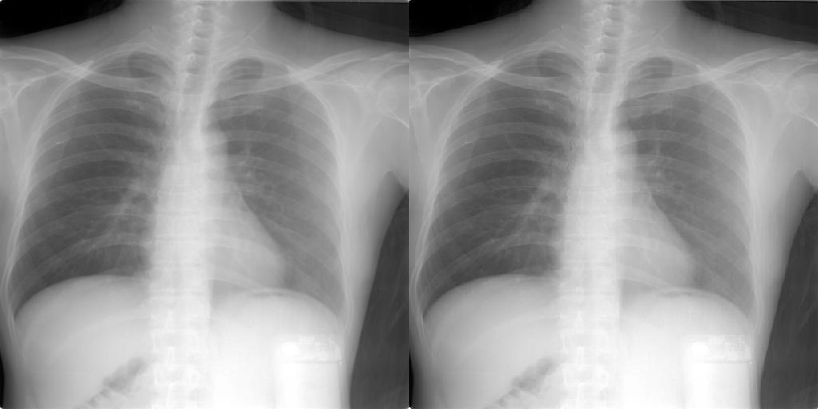

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
import os
import random
import cv2
import numpy as np
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow
from detectron2.data import MetadataCatalog

# Config ve predictor ayarları
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = "/content/output/model_final.pth"  # Model dosyanın yolu
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
predictor = DefaultPredictor(cfg)

# Test klasörü
image_dir = "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/test"
image_files = [f for f in os.listdir(image_dir) if f.endswith(".jpg")]

sampled_images = random.sample(image_files, 10)

for img_file in sampled_images:
    img_path = os.path.join(image_dir, img_file)
    im = cv2.imread(img_path)

    outputs = predictor(im)

    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get("foreign_object_train"), scale=0.8)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    pred_img = out.get_image()[:, :, ::-1]

    height = min(im.shape[0], pred_img.shape[0])
    width = min(im.shape[1], pred_img.shape[1])
    im_resized = cv2.resize(im, (width, height))
    pred_resized = cv2.resize(pred_img, (width, height))

    combined = np.hstack((im_resized, pred_resized))
    print(f"Resim: {img_file}")
    cv2_imshow(combined)


**Model-4**

In [ ]:
import os
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.data import transforms as T

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))

#Veri Ayarları
cfg.DATASETS.TRAIN = ("foreign_object_train",)
cfg.DATASETS.TEST = ("foreign_object_val",)
cfg.DATALOADER.NUM_WORKERS = 2  # GPU'ya bağlı olarak artırılabilir
cfg.INPUT.MASK_FORMAT = "polygon"  # X-Ray'ler için optimal format

#Model Ağırlıkları
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")

#Optimizasyon Parametreleri
cfg.SOLVER.IMS_PER_BATCH = 2  # GPU belleğine göre ayarla
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 200
cfg.SOLVER.MAX_ITER = 2500
cfg.SOLVER.STEPS = [1800, 2200]  # Learning rate düşürme adımları
cfg.SOLVER.GAMMA = 0.1
cfg.SOLVER.CHECKPOINT_PERIOD = 250  # Her 250 iterasyonda bir kayıt

# Gradyan Kırpma
cfg.SOLVER.CLIP_GRADIENTS.ENABLED = True
cfg.SOLVER.CLIP_GRADIENTS.CLIP_VALUE = 1.0

# Backbone Dondurma
cfg.MODEL.BACKBONE.FREEZE_AT = 2  # İlk 2 katman donuk

# Eğitim çıktıları buraya kaydedilecek
model_name="model_4"
output_dir = f"/content/drive/MyDrive/detectron2_outputs/{model_name}"

#Klasör yoksa oluştur
os.makedirs(output_dir, exist_ok=True)

# Detectron2 config çıktısını buraya yönlendir
cfg.OUTPUT_DIR = output_dir

In [ ]:
from detectron2.engine import DefaultTrainer

trainer = DefaultTrainer(cfg) # modeli oluştur,dataseti yükle,eğitimi başlat ve takip et
trainer.resume_or_load(resume=False) #eğitim sıfırdan başlar
trainer.train()

[06/03 18:18:07 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

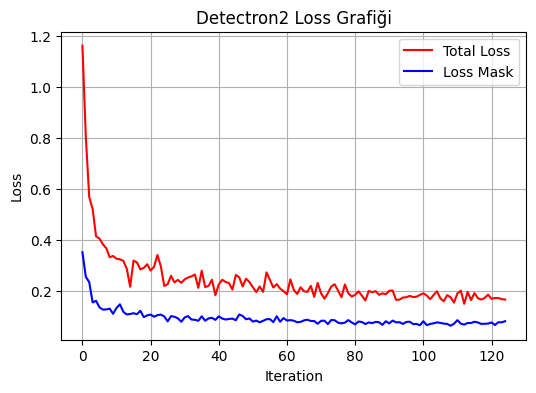

In [ ]:
plot_detectron2_loss("/content/drive/MyDrive/detectron2_outputs/model_4/metrics.json", show_mask_loss=True)

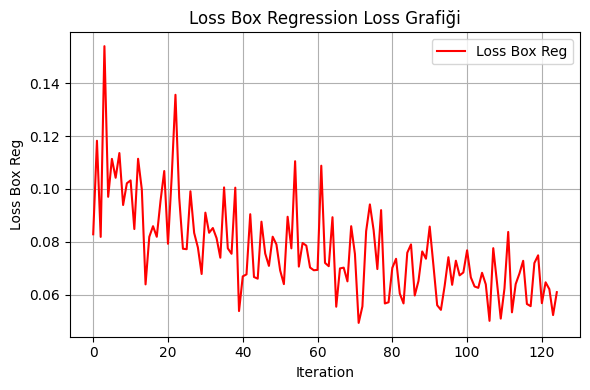

In [ ]:
plot_loss_box_reg("/content/drive/MyDrive/detectron2_outputs/model_4/metrics.json")

[06/03 18:46:56 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_outputs/model_4/model_final.pth ...


roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


Resim: 08459_jpg.rf.e8b9d74fe4098bed530797e76430f776.jpg


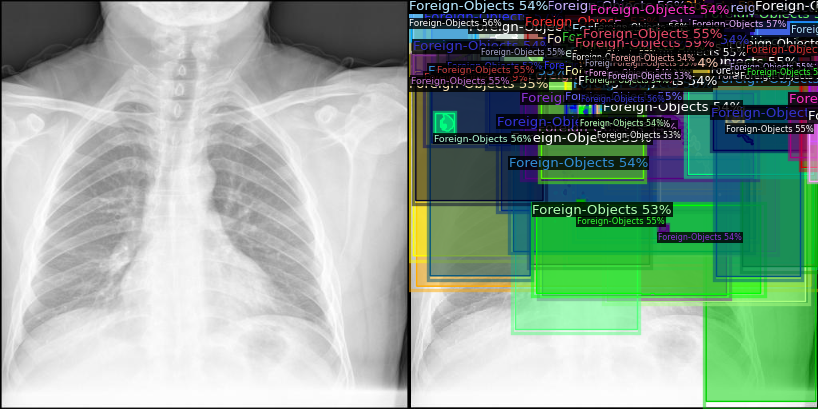

Resim: 08135_jpg.rf.3cd1b0ecea8905c95e7b9fafb67a3cdb.jpg


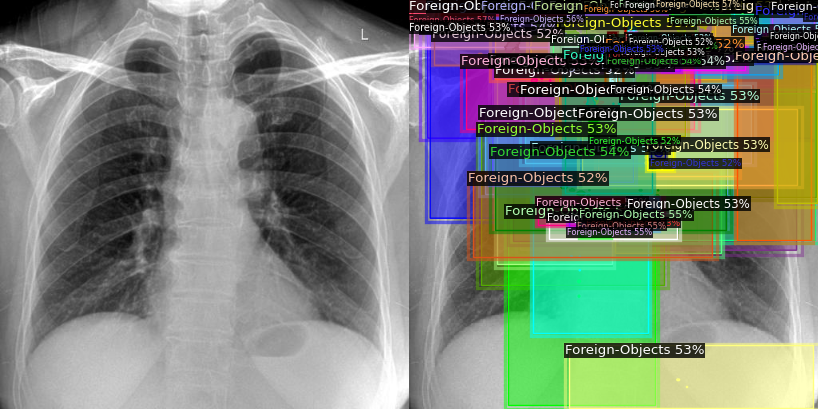

Resim: 08937_jpg.rf.4a2546b12e8a8add2b7c7fa70974703e.jpg


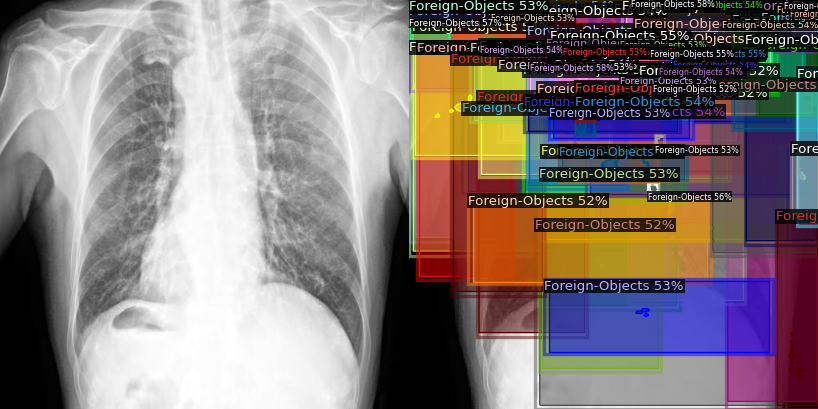

Resim: 08592_jpg.rf.167cc3f59744d962a1d31a02793b2ef1.jpg


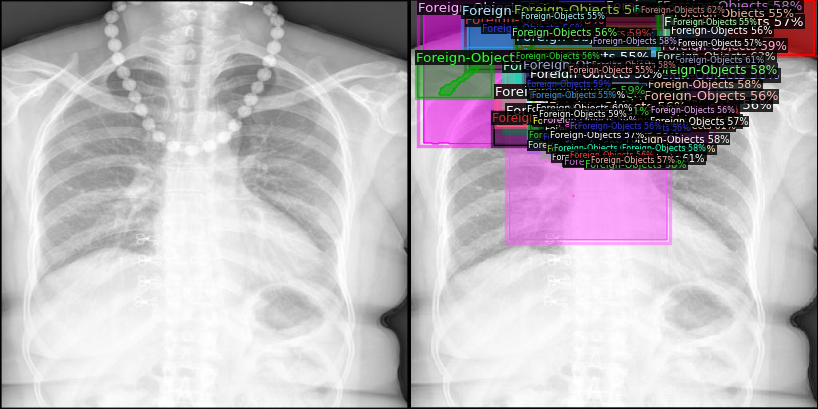

Resim: 08714_jpg.rf.91a96739dc92cc634f9abcf602477f1f.jpg


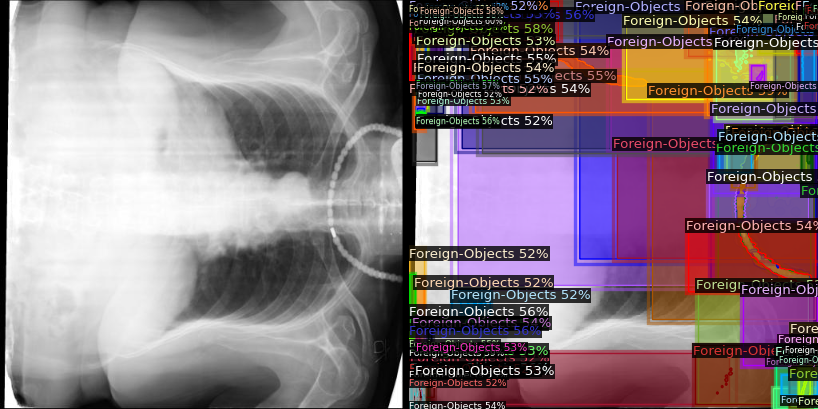

Resim: 08045_jpg.rf.fdb7a297accae6261aac7128ab07545b.jpg


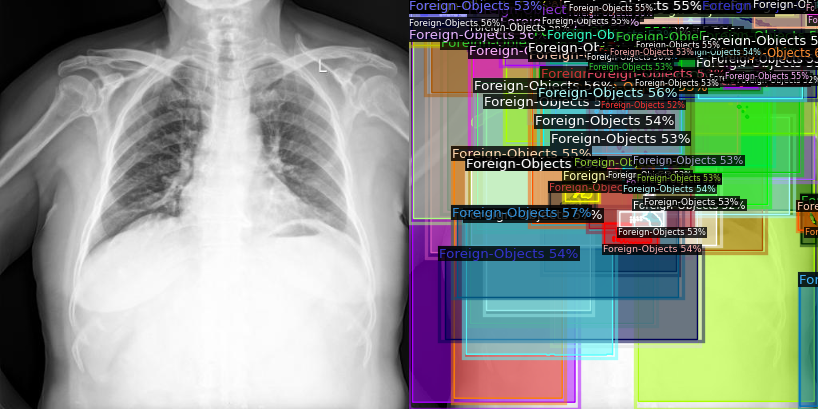

Resim: 08405_jpg.rf.fccf81ce30199f4800f4bbc52f1f11f5.jpg


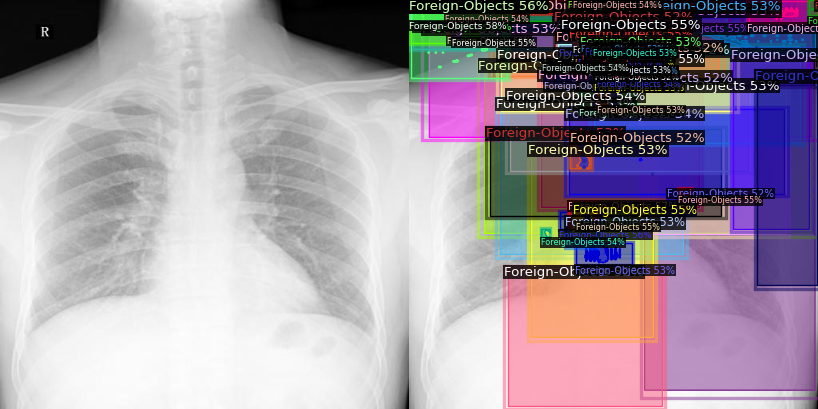

Resim: 08301_jpg.rf.ab176911fcfdde03b315a218f04f3d46.jpg


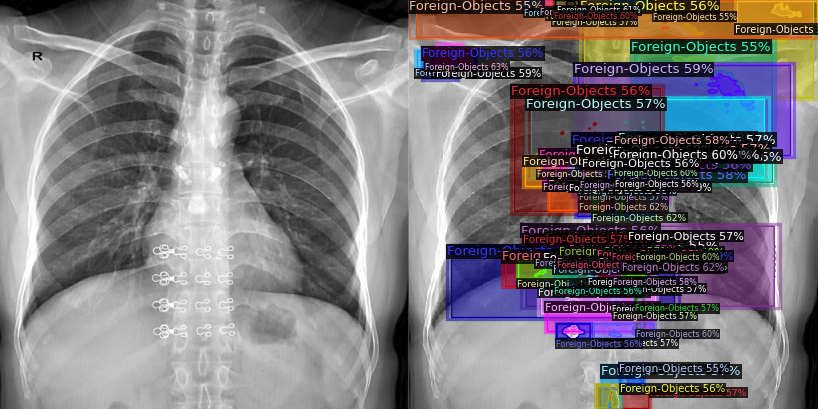

Resim: 08087_jpg.rf.90cdd009f8ebd3b7457274b507daaff7.jpg


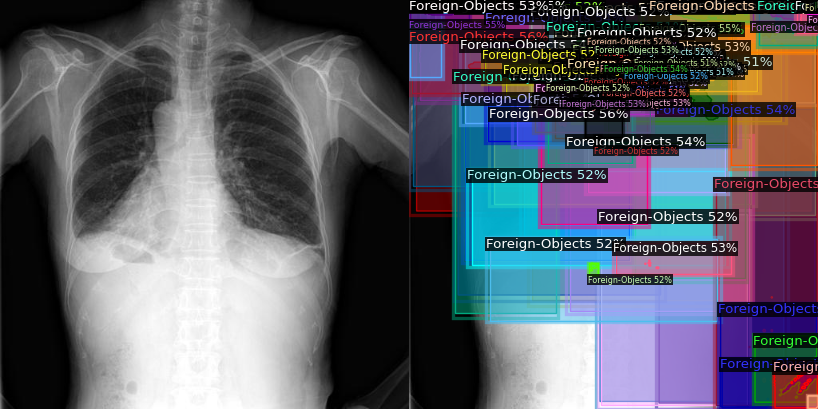

Resim: 08601_jpg.rf.4f7c08a4d367f7f2b1cd5368351bf3b8.jpg


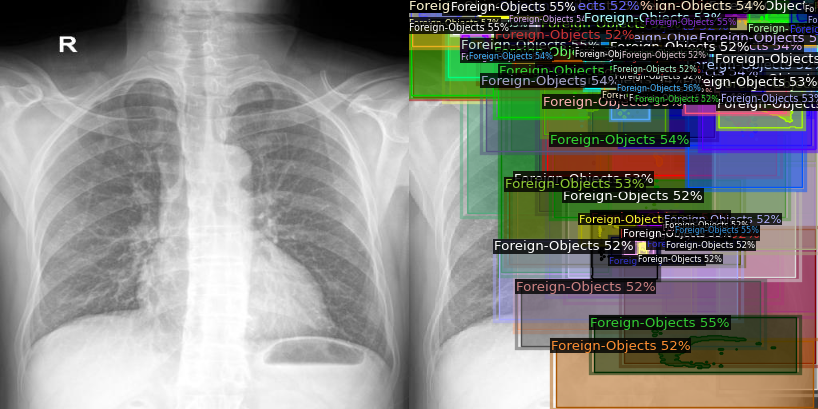

In [ ]:
random_predict_and_visualize(cfg, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/test", num_samples=10)


**Model-5**

In [ ]:
import os
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.data import transforms as T

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

#Veri Ayarları
cfg.DATASETS.TRAIN = ("foreign_object_train",)
cfg.DATASETS.TEST = ("foreign_object_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.INPUT.MASK_FORMAT = "polygon"

#Model Ağırlıkları
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

cfg.INPUT.MIN_SIZE_TRAIN = (512,)
cfg.INPUT.MAX_SIZE_TRAIN = 512
cfg.INPUT.MIN_SIZE_TEST = 512
cfg.INPUT.MAX_SIZE_TEST = 512

#Optimizasyon Parametreleri
cfg.SOLVER.IMS_PER_BATCH = 2  # GPU belleğine göre ayarla
cfg.SOLVER.BASE_LR = 0.0001
cfg.SOLVER.WARMUP_ITERS = 100
cfg.SOLVER.MAX_ITER = 1500
cfg.SOLVER.STEPS = [1800, 1300]  # Learning rate düşürme adımları
cfg.SOLVER.GAMMA = 0.1
cfg.SOLVER.CHECKPOINT_PERIOD = 250  # Her 250 iterasyonda bir kayıt

# Gradyan Kırpma
cfg.SOLVER.CLIP_GRADIENTS.ENABLED = True
cfg.SOLVER.CLIP_GRADIENTS.CLIP_VALUE = 1.0

# Backbone Dondurma
cfg.MODEL.BACKBONE.FREEZE_AT = 4  # İlk 4 katman donuk
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

# Eğitim çıktıları buraya kaydedilecek
model_name="model_5"

output_dir = f"/content/drive/MyDrive/detectron2_outputs/{model_name}"

os.makedirs(output_dir, exist_ok=True)

cfg.OUTPUT_DIR = output_dir

In [ ]:
from detectron2.engine import DefaultTrainer

trainer = DefaultTrainer(cfg) # modeli oluştur,dataseti yükle,eğitimi başlat ve takip et
trainer.resume_or_load(resume=False) #eğitim sıfırdan başlar
trainer.train()

[06/03 18:54:42 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:00, 268MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[06/03 18:54:42 d2.engine.train_loop]: Starting training from iteration 0
[06/03 18:54:46 d2.utils.events]:  eta: 0:03:45  iter: 19  total_loss: 1.986  loss_cls: 0.6647  loss_box_reg: 0.2808  loss_mask: 0.6898  loss_rpn_cls: 0.3512  loss_rpn_loc: 0.01913    time: 0.1514  last_time: 0.1422  data_time: 0.0153  last_data_time: 0.0056   lr: 1.9081e-05  max_mem: 3556M
[06/03 18:54:49 d2.utils.events]:  eta: 0:03:43  iter: 39  total_loss: 2.119  loss_cls: 0.5026  loss_box_reg: 0.4161  loss_mask: 0.6753  loss_rpn_cls: 0.5004  loss_rpn_loc: 0.05378    time: 0.1541  last_time: 0.1452  data_time: 0.0049  last_data_time: 0.0040   lr: 3.9061e-05  max_mem: 3556M
[06/03 18:54:53 d2.utils.events]:  eta: 0:03:44  iter: 59  total_loss: 1.756  loss_cls: 0.3685  loss_box_reg: 0.4477  loss_mask: 0.6354  loss_rpn_cls: 0.2025  loss_rpn_loc: 0.05629    time: 0.1613  last_time: 0.2546  data_time: 0.0083  last_data_time: 0.0282   lr: 5.9041e-05  max_mem: 3556M
[06/03 18:54:56 d2.utils.events]:  eta: 0:03:43  i

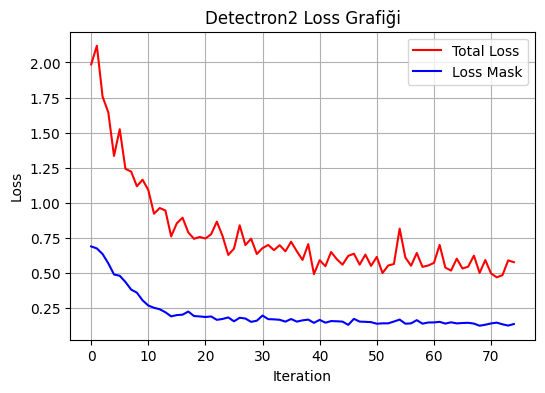

In [ ]:
plot_detectron2_loss("/content/drive/MyDrive/detectron2_outputs/model_5/metrics.json", show_mask_loss=True)

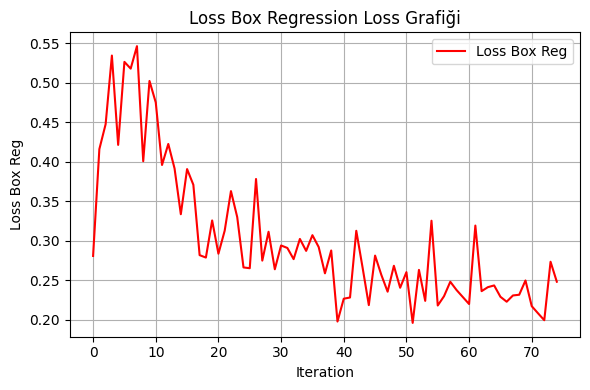

In [ ]:
plot_loss_box_reg("/content/drive/MyDrive/detectron2_outputs/model_5/metrics.json")

[06/03 19:01:14 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_outputs/model_5/model_final.pth ...
Resim: 08405_jpg.rf.fccf81ce30199f4800f4bbc52f1f11f5.jpg


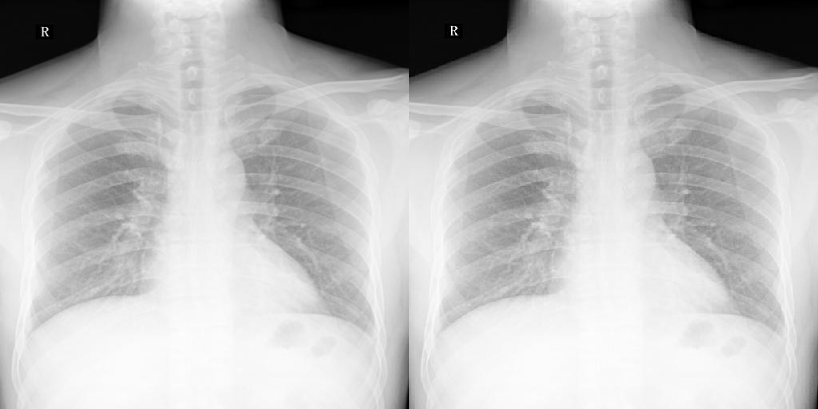

Resim: 08441_jpg.rf.b058c3faaaacd0b7f174bff768401dd8.jpg


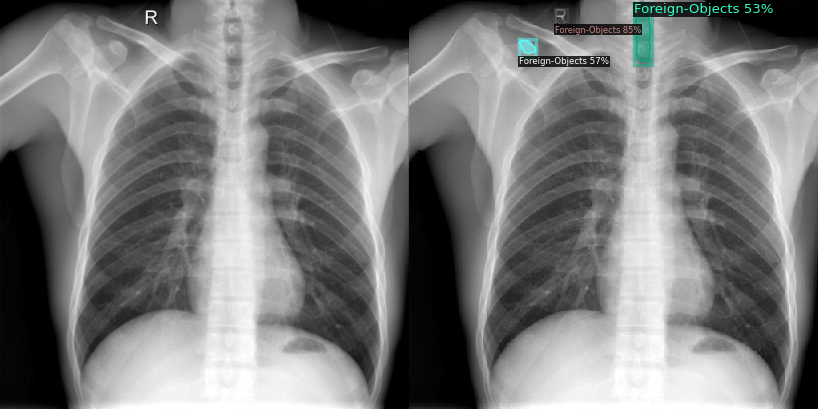

Resim: 08979_jpg.rf.dcc6614b18852b018779cfcd4a57a1ff.jpg


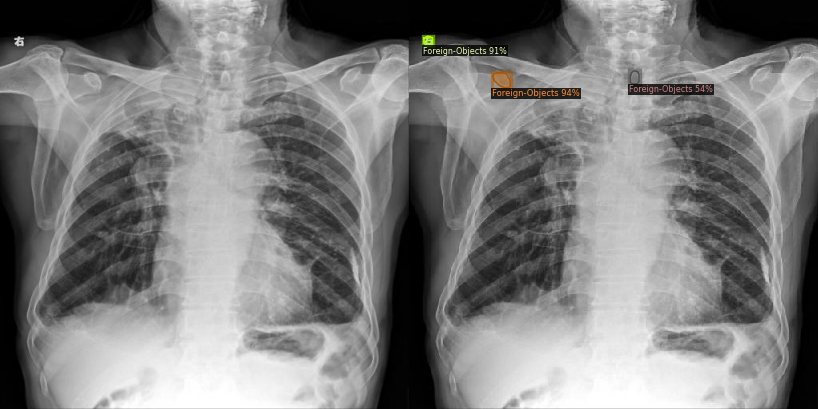

Resim: 08442_jpg.rf.59c900a14f6c08642ad1a42463adbe1a.jpg


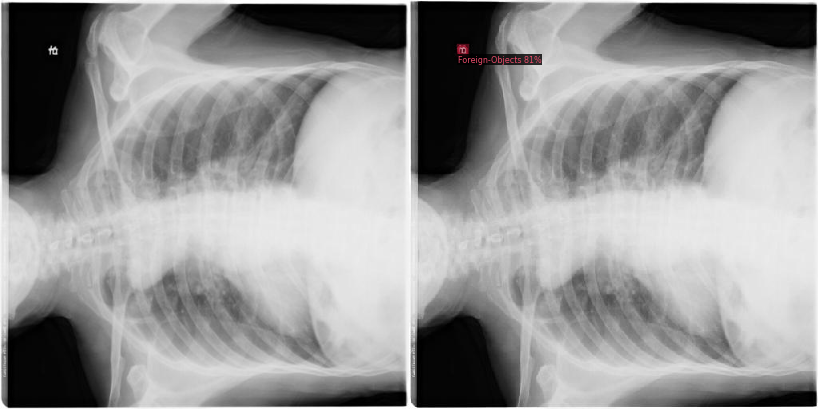

Resim: 08457_jpg.rf.184d6135eb8f8766c58d310f98ffda28.jpg


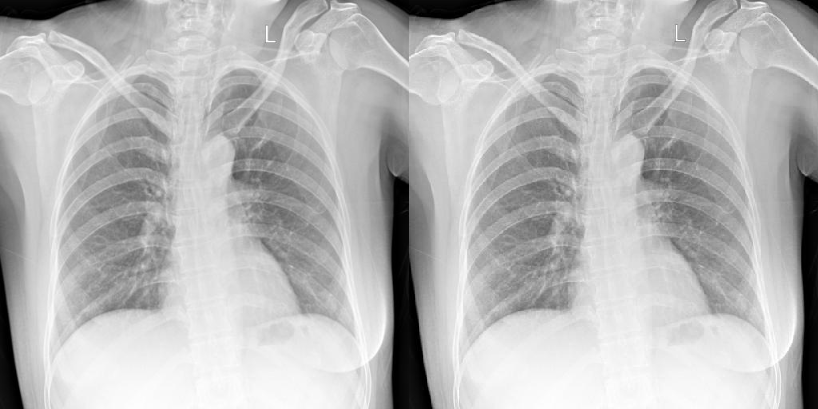

Resim: 08445_jpg.rf.be4eb59ab942c15700825fa0e0ed11e6.jpg


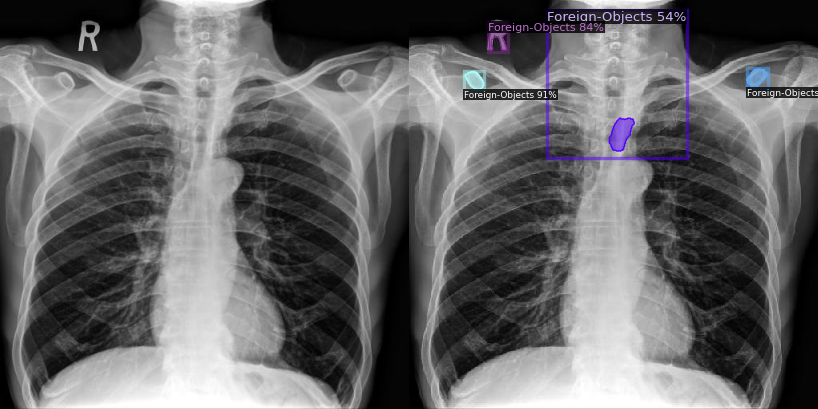

Resim: 08219_jpg.rf.3ccdebf7bbe4f6e52b3b1d23e23da1c8.jpg


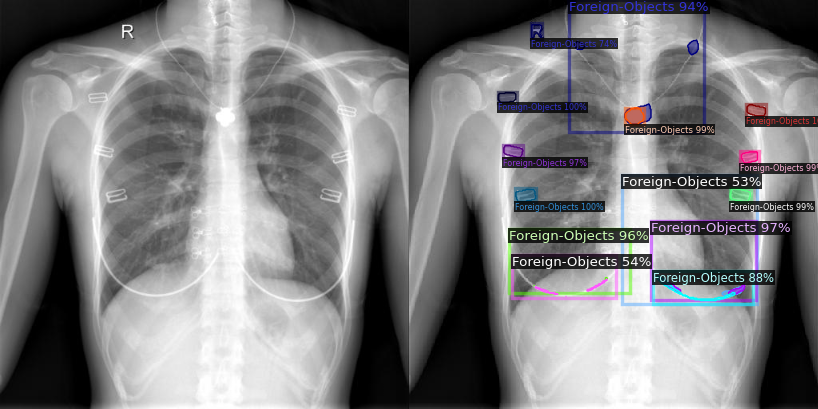

Resim: 08203_jpg.rf.ac095d53a2b35d9b12d079205221a1f6.jpg


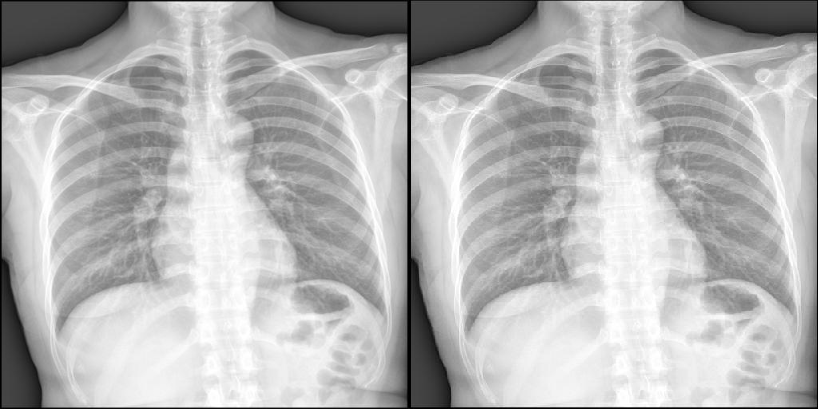

Resim: 08774_jpg.rf.7f47603e2eb6230ddd640767853956e7.jpg


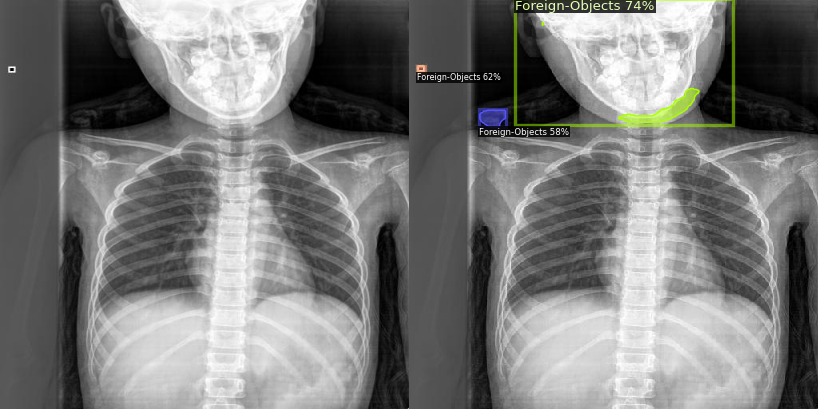

Resim: 08989_jpg.rf.099450a136ec2ffa493d41107cd06fd5.jpg


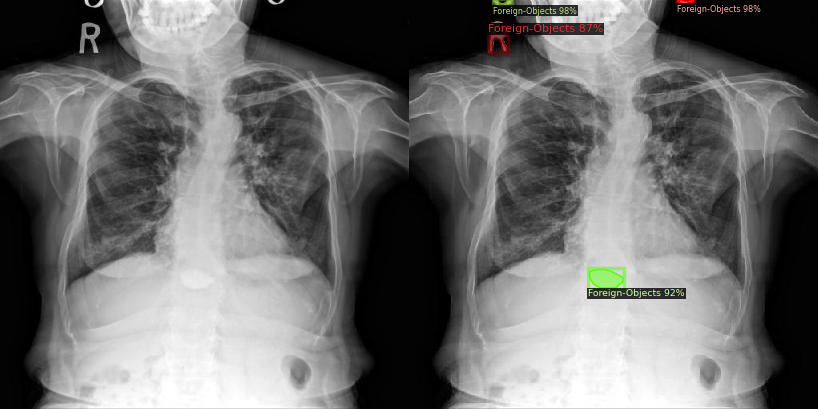

In [ ]:
random_predict_and_visualize(cfg, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/test", num_samples=10)

**KULLANILACAK MODEL (MODEL-6)**

In [ ]:
import os
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.data import transforms as T

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

#Veri Ayarları
cfg.DATASETS.TRAIN = ("foreign_object_train",)
cfg.DATASETS.TEST = ("foreign_object_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.INPUT.MASK_FORMAT = "polygon"

#Model Ağırlıkları
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

cfg.INPUT.MIN_SIZE_TRAIN = (512,)
cfg.INPUT.MAX_SIZE_TRAIN = 512
cfg.INPUT.MIN_SIZE_TEST = 512
cfg.INPUT.MAX_SIZE_TEST = 512

#Optimizasyon Parametreleri
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.0025
cfg.SOLVER.WARMUP_ITERS = 150
cfg.SOLVER.MAX_ITER = 2000
cfg.SOLVER.STEPS = [1500, 1800]
cfg.SOLVER.GAMMA = 0.1


# Gradyan Kırpma
cfg.SOLVER.CLIP_GRADIENTS.ENABLED = True
cfg.SOLVER.CLIP_GRADIENTS.CLIP_VALUE = 1.0
cfg.MODEL.BACKBONE.FREEZE_AT = 2
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

#Veri artırma
cfg.INPUT.RANDOM_FLIP = "horizontal"
cfg.INPUT.CROP.ENABLED = True
cfg.INPUT.CROP.TYPE = "relative_range"
cfg.INPUT.CROP.SIZE = (0.8, 0.8)  # %20 crop

model_name="model_6"
output_dir = f"/content/drive/MyDrive/detectron2_outputs/{model_name}"

# 4. Klasör yoksa oluştur
os.makedirs(output_dir, exist_ok=True)

# 5. Detectron2 config çıktısını buraya yönlendir
cfg.OUTPUT_DIR = output_dir

In [ ]:
from detectron2.engine import DefaultTrainer

trainer = DefaultTrainer(cfg) # modeli oluştur,dataseti yükle,eğitimi başlat ve takip et
trainer.resume_or_load(resume=False) #eğitim sıfırdan başlar
trainer.train()

[06/04 09:10:36 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:02, 86.0MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[06/04 09:10:40 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[06/04 09:11:24 d2.utils.events]:  eta: 1:00:05  iter: 19  total_loss: 1.974  loss_cls: 0.4835  loss_box_reg: 0.4317  loss_mask: 0.6852  loss_rpn_cls: 0.2844  loss_rpn_loc: 0.05222    time: 1.8271  last_time: 1.6271  data_time: 1.7488  last_data_time: 1.3137   lr: 0.00031885  max_mem: 1572M
[06/04 09:12:09 d2.utils.events]:  eta: 0:57:56  iter: 39  total_loss: 1.568  loss_cls: 0.3378  loss_box_reg: 0.5504  loss_mask: 0.4535  loss_rpn_cls: 0.1153  loss_rpn_loc: 0.05762    time: 1.7433  last_time: 1.5996  data_time: 1.3267  last_data_time: 1.2948   lr: 0.00065185  max_mem: 1610M
[06/04 09:12:42 d2.utils.events]:  eta: 0:55:47  iter: 59  total_loss: 1.042  loss_cls: 0.2047  loss_box_reg: 0.433  loss_mask: 0.2431  loss_rpn_cls: 0.07422  loss_rpn_loc: 0.04457    time: 1.7213  last_time: 1.7148  data_time: 1.3617  last_data_time: 1.3913   lr: 0.00098485  max_mem: 1610M
[06/04 09:13:17 d2.utils.events]:  eta: 0:55:13  iter: 79  total_loss: 0.7156  loss_cls: 0.141  loss_box_reg: 0.3066  loss_m

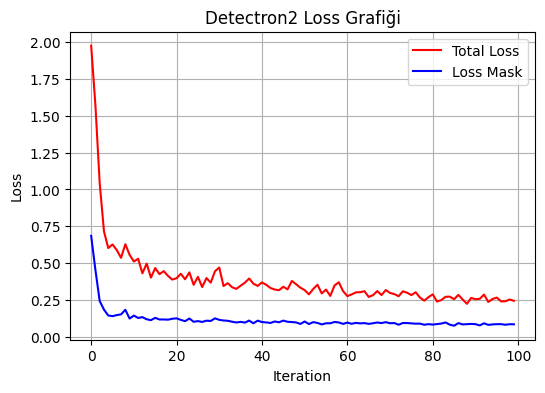

In [ ]:
plot_detectron2_loss("/content/drive/MyDrive/detectron2_outputs/model_6/metrics.json", show_mask_loss=True)

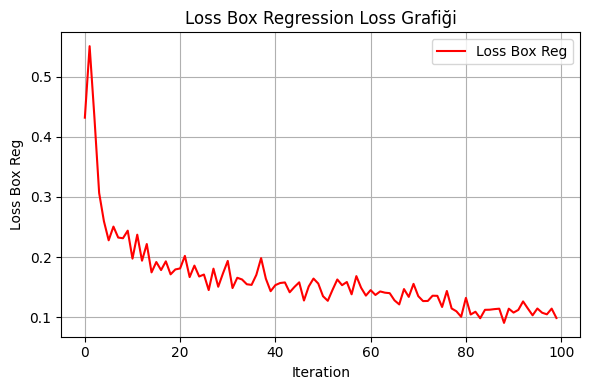

In [ ]:
plot_loss_box_reg("/content/drive/MyDrive/detectron2_outputs/model_6/metrics.json")

[06/04 09:28:35 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_outputs/model_6/model_final.pth ...
Resim: 08046_jpg.rf.c3763dc732c90895389fb727fff4a607.jpg


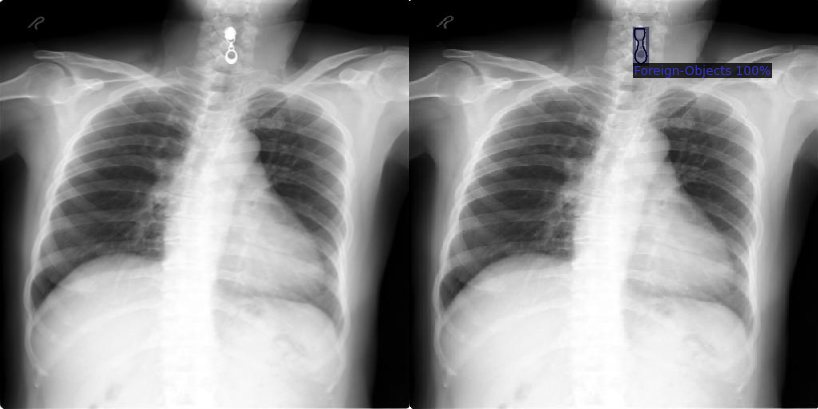

Resim: 08167_jpg.rf.4c957a13f258ea0668c47a3495bafce9.jpg


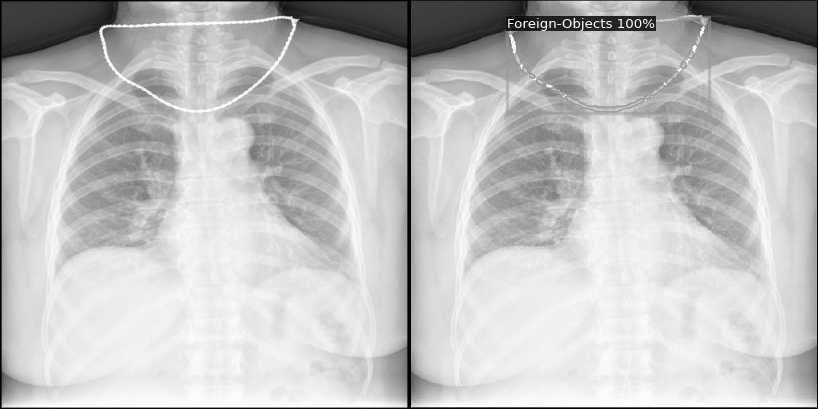

Resim: 08455_jpg.rf.e6f95b052b00767111ef92f367d3ca6a.jpg


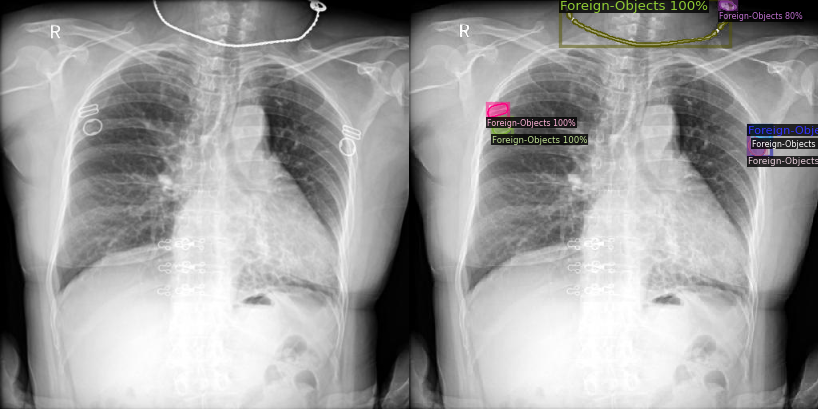

Resim: 08642_jpg.rf.7b0b969fce5dbae4b82007f1ae69071c.jpg


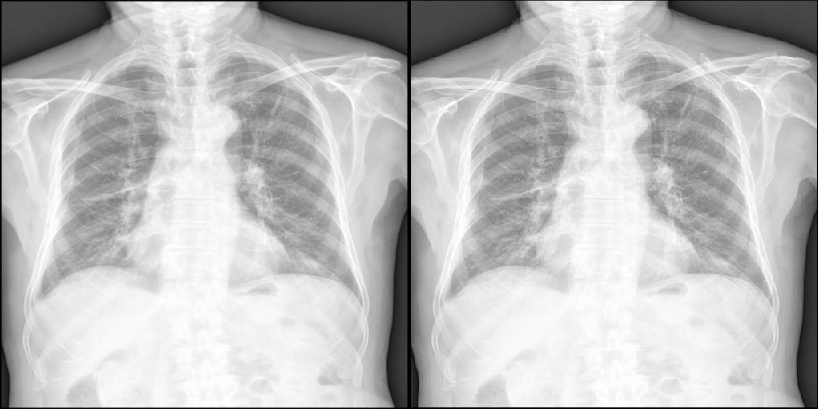

Resim: 08459_jpg.rf.e8b9d74fe4098bed530797e76430f776.jpg


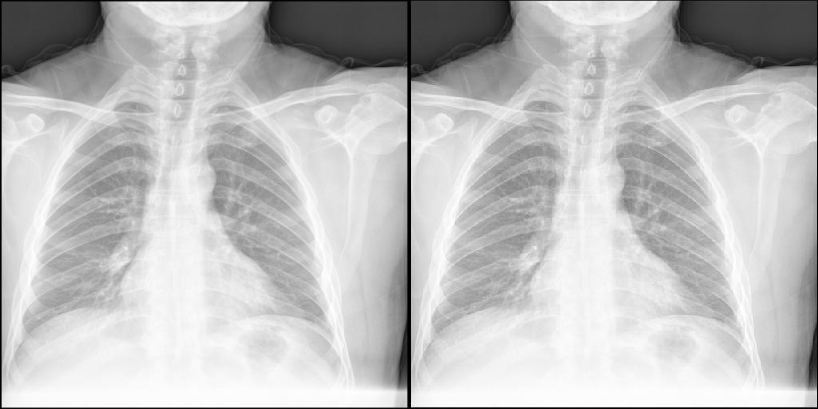

Resim: 08391_jpg.rf.eefa337c07f9b8da593288e48d808105.jpg


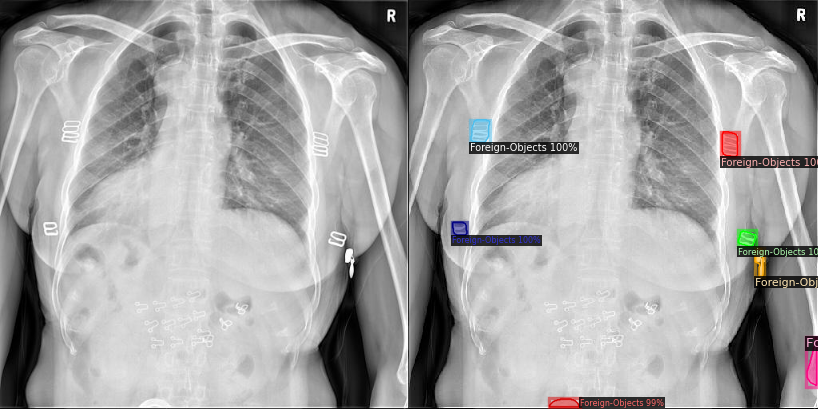

Resim: 08714_jpg.rf.91a96739dc92cc634f9abcf602477f1f.jpg


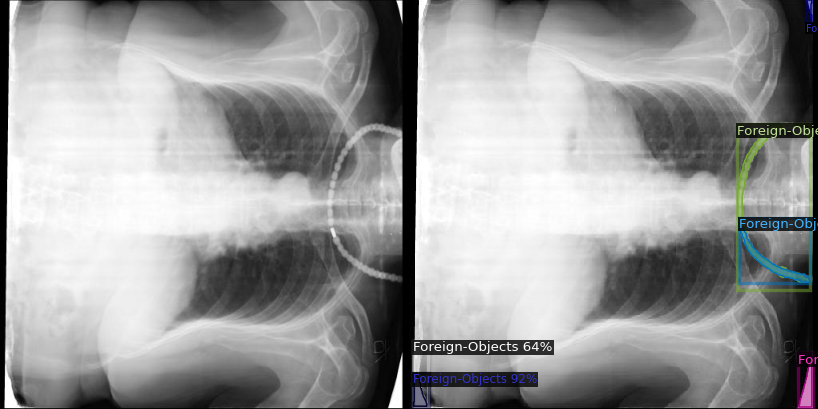

Resim: 08601_jpg.rf.4f7c08a4d367f7f2b1cd5368351bf3b8.jpg


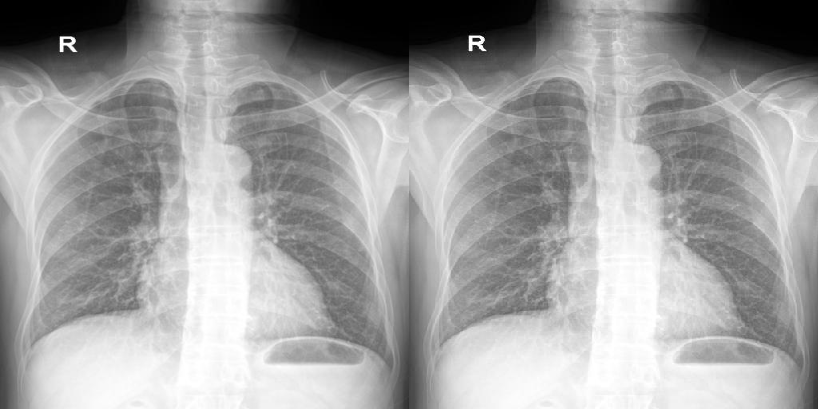

Resim: 08968_jpg.rf.d8142bfca4206af6ea70c030dc376790.jpg


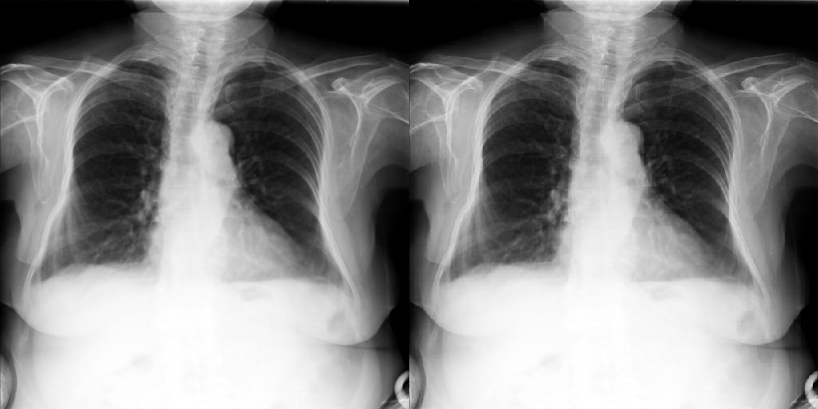

Resim: 08507_jpg.rf.2093f677f2e82935935b552bb068e207.jpg


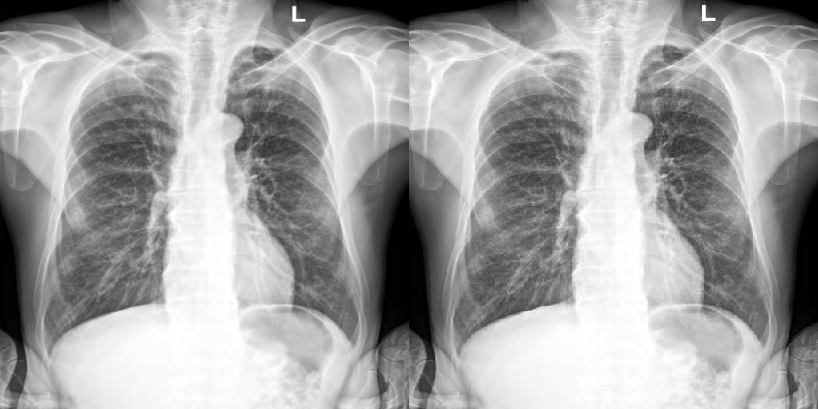

In [ ]:
random_predict_and_visualize(cfg, "/content/drive/MyDrive/X-Ray Segmentation.v1i.coco-segmentation/test", num_samples=10)

**BOUNDİNG BOX'LARI KALDIRMA**

In [ ]:
import os
import random
import cv2
import numpy as np
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
from google.colab.patches import cv2_imshow

def rastgele_maskeli_gorselleri_goster_yanyana(cfg, dataset_name="foreign_object_val", adet=10):

    cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/drive/MyDrive/detectron2_outputs/model_6/model_final.pth")
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    predictor = DefaultPredictor(cfg)

    veri = DatasetCatalog.get(dataset_name)
    örnekler = random.sample(veri, adet)

    for örnek in örnekler:
        image = cv2.imread(örnek["file_name"])
        outputs = predictor(image)

        instances = outputs["instances"].to("cpu")
        # Bbox'ları kaldır
        instances.pred_boxes.tensor *= 0

        visualizer = Visualizer(
            image[:, :, ::-1],  # BGR->RGB
            MetadataCatalog.get(dataset_name),
            scale=1.0,
            instance_mode=ColorMode.IMAGE_BW
        )

        maskeli_img = visualizer.draw_instance_predictions(instances).get_image()[:, :, ::-1]
        maskeli_img = maskeli_img.copy()
        maskeli_img = maskeli_img.astype("uint8")

        # Skorları yaz
        scores = instances.scores.cpu().numpy()
        boxes = instances.pred_boxes.tensor.cpu().numpy()

        for i, score in enumerate(scores):
            box = boxes[i]
            x, y = int(box[0]), int(box[1])
            text = f"{score:.2f}"
            # Skorları bbox üstüne yaz
            cv2.putText(maskeli_img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX,
                        0.6, (0, 255, 0), 2, cv2.LINE_AA)

        # Yan yana birleştir
        h = max(image.shape[0], maskeli_img.shape[0])
        w = image.shape[1] + maskeli_img.shape[1]

        combined = np.zeros((h, w, 3), dtype=np.uint8)
        combined[:image.shape[0], :image.shape[1], :] = image
        combined[:maskeli_img.shape[0], image.shape[1]:, :] = maskeli_img

        print(f"Görsel: {os.path.basename(örnek['file_name'])}")
        cv2_imshow(combined)


/usr/local/lib/python3.11/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Görsel: 08651_jpg.rf.7dedd852c6e3b00adb2cf9941cabb0c0.jpg


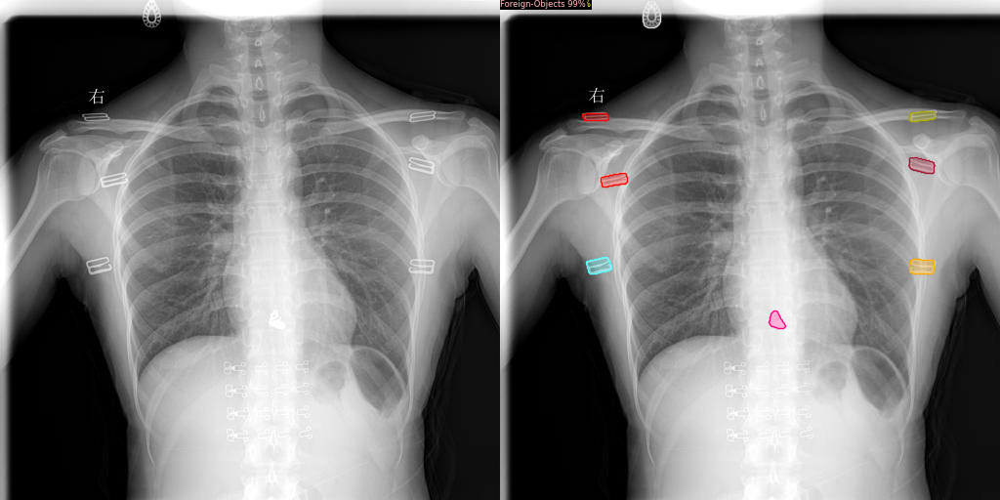

Görsel: 08027_jpg.rf.e89cf4a5044f95946430a5c92721abdd.jpg


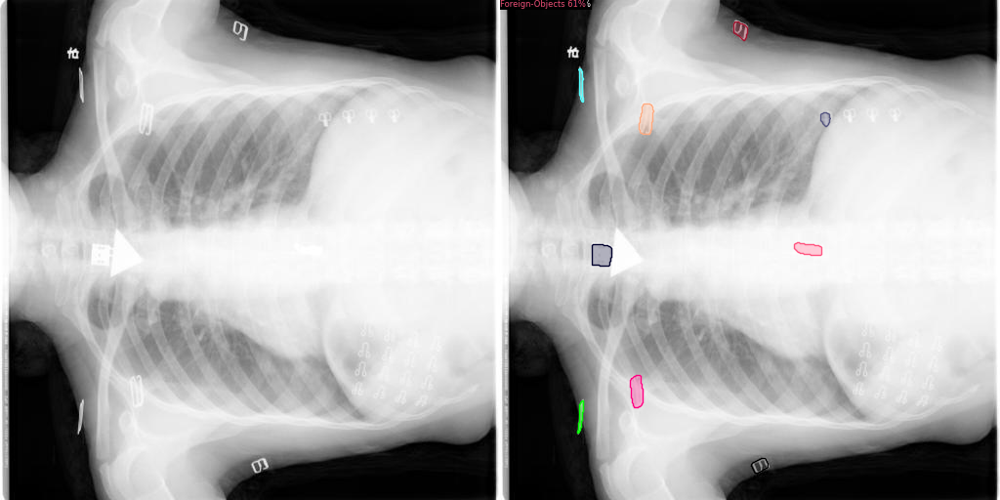

Görsel: 08499_jpg.rf.e28ba411964a0516feadfcfdb7191c32.jpg


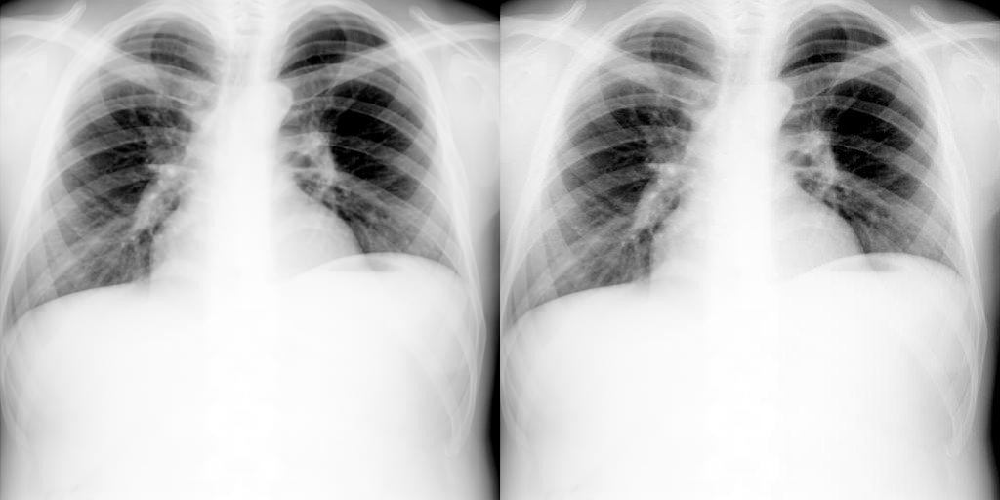

Görsel: 08595_jpg.rf.915b8adfb5329861ad03b6a4fb39f86a.jpg


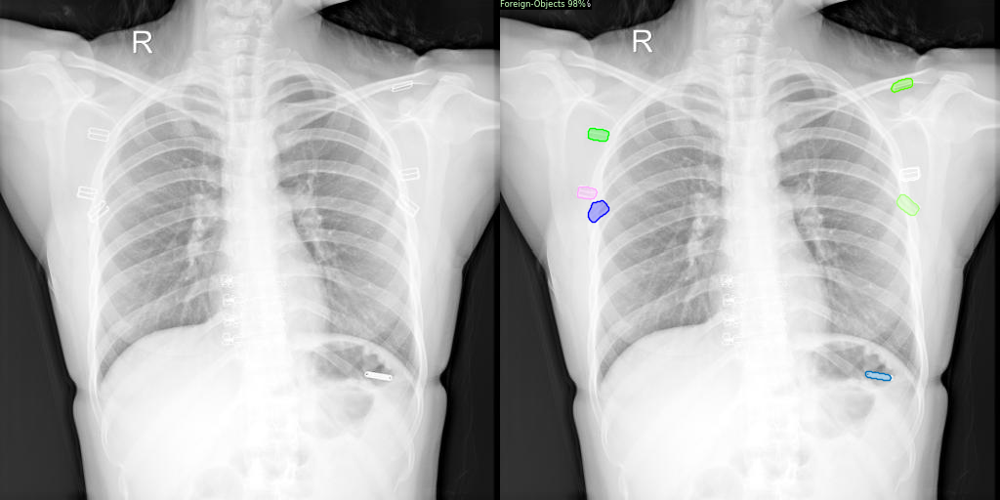

Görsel: 08921_jpg.rf.cb33c0b43db0c7bfec1636c68b9d9f8d.jpg


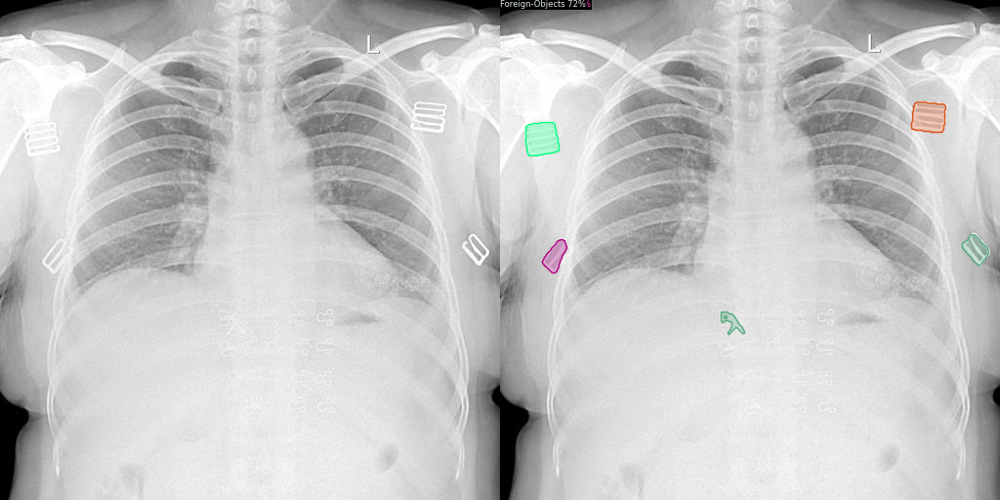

Görsel: 08609_jpg.rf.9ef92ec5044305eb12873ad26046c158.jpg


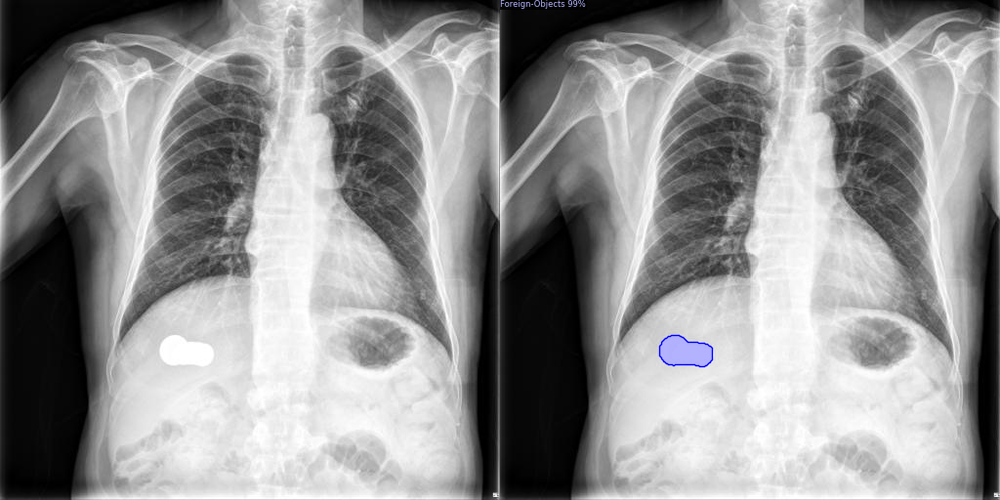

Görsel: 08767_jpg.rf.464b4243e0f3646634149421b6c98995.jpg


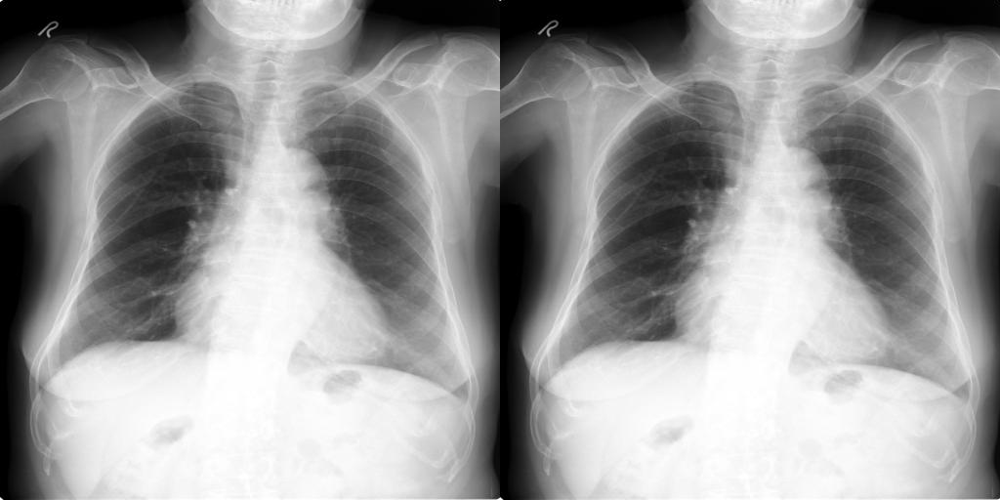

Görsel: 08679_jpg.rf.5455562038dbb6359d2afb3a727257bc.jpg


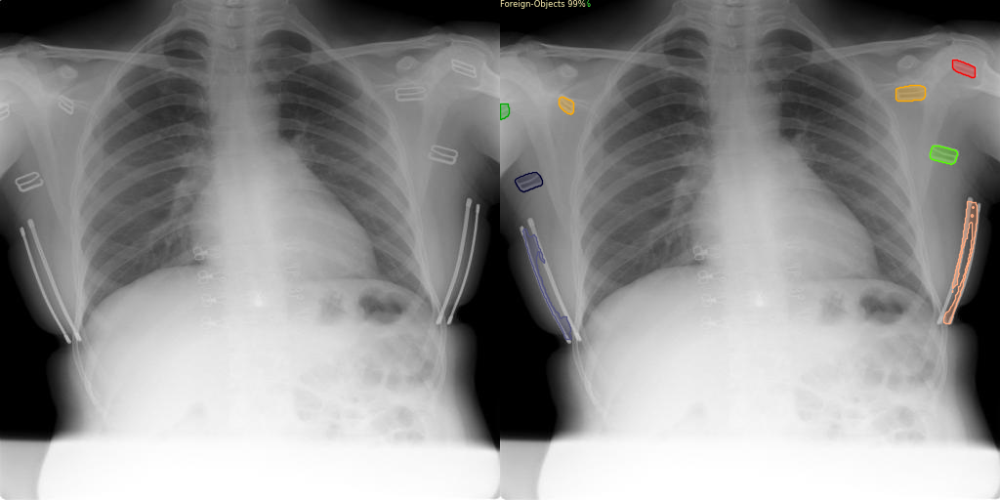

Görsel: 08232_jpg.rf.234566e1cdb5f559bf8b8801bea3d840.jpg


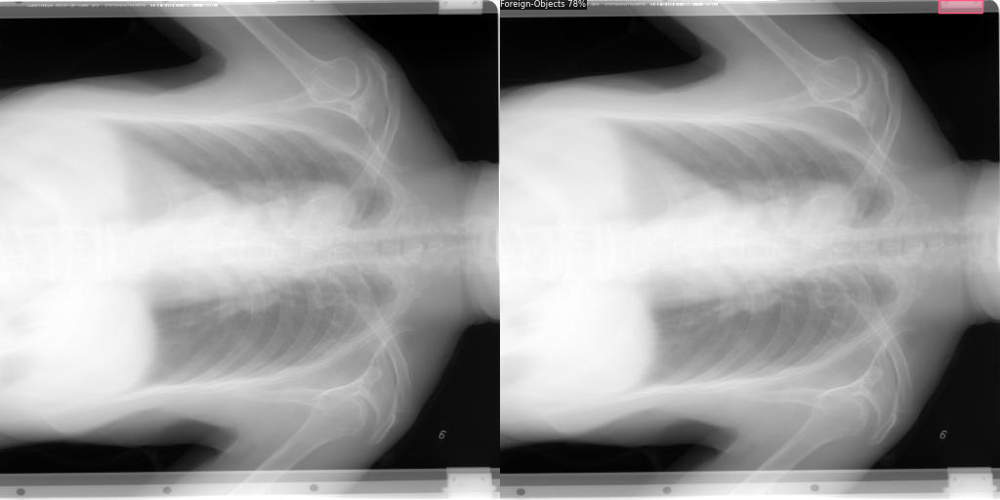

Görsel: 08030_jpg.rf.b0cff1550346a22b679ed5dc6162fabe.jpg


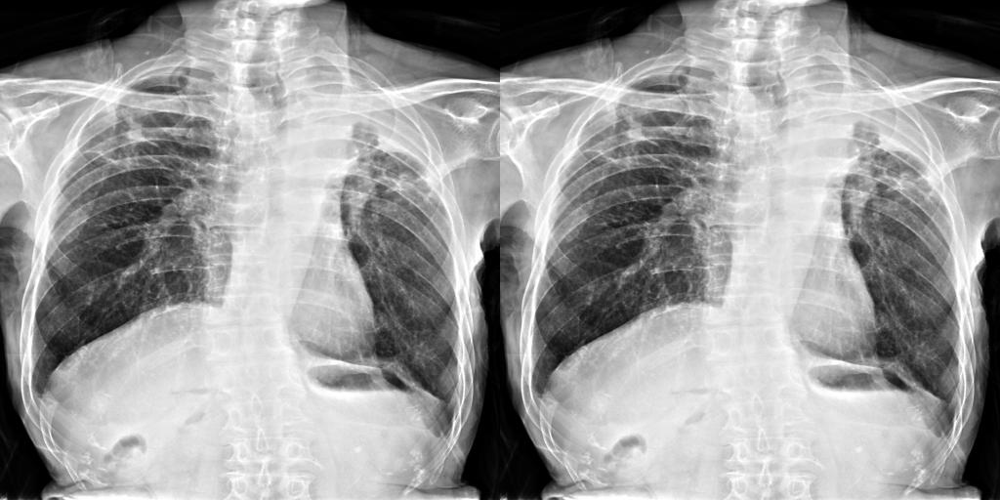

In [ ]:
rastgele_maskeli_gorselleri_goster_yanyana(cfg, dataset_name="foreign_object_val", adet=10)


In [ ]:
import os
import random
import cv2
import numpy as np
from detectron2.engine import DefaultPredictor
from detectron2.data import MetadataCatalog, DatasetCatalog
from google.colab.patches import cv2_imshow

def draw_rounded_rectangle(img, top_left, bottom_right, color, radius=5):
    x1, y1 = top_left
    x2, y2 = bottom_right
    r = radius

    # Orta dikdörtgenler
    cv2.rectangle(img, (x1 + r, y1), (x2 - r, y2), color, thickness=cv2.FILLED)
    cv2.rectangle(img, (x1, y1 + r), (x2, y2 - r), color, thickness=cv2.FILLED)

    # 4 adet köşe için çeyrek daireler
    cv2.ellipse(img, (x1 + r, y1 + r), (r, r), 180, 0, 90, color, thickness=cv2.FILLED)
    cv2.ellipse(img, (x2 - r, y1 + r), (r, r), 270, 0, 90, color, thickness=cv2.FILLED)
    cv2.ellipse(img, (x2 - r, y2 - r), (r, r), 0, 0, 90, color, thickness=cv2.FILLED)
    cv2.ellipse(img, (x1 + r, y2 - r), (r, r), 90, 0, 90, color, thickness=cv2.FILLED)


def rastgele_maskeli_gorselleri_goster_yanyana(cfg, dataset_name="foreign_object_val", adet=5):
    cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/drive/MyDrive/detectron2_outputs/model_6/model_final.pth")
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    predictor = DefaultPredictor(cfg)

    metadata = MetadataCatalog.get(dataset_name)
    dataset_dicts = DatasetCatalog.get(dataset_name)
    selected_samples = random.sample(dataset_dicts, min(adet, len(dataset_dicts)))


    for d in selected_samples:
        im = cv2.imread(d["file_name"])
        if im is None:
            print("Görsel okunamadı:", d["file_name"])
            continue

        im_masked = im.copy()

        outputs = predictor(im)
        instances = outputs["instances"].to("cpu")
        masks = instances.pred_masks.numpy()
        scores = instances.scores.numpy()

        for i, mask in enumerate(masks):
            color = tuple(random.choices(range(50, 256), k=3))

            # Maskeyi koyu ve transparan yap
            alpha = 0.7
            for c in range(3):
                im_masked[:, :, c] = np.where(mask,
                                              im_masked[:, :, c] * (1 - alpha) + color[c] * alpha,
                                              im_masked[:, :, c])

            # Maskenin etrafına ince kontur çiz (kalınlık=1)
            contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            cv2.drawContours(im_masked, contours, -1, color, thickness=1)

            # Skor yazısı için koordinat belirle
            yx = np.argwhere(mask)
            if yx.size > 0:
                y_min, x_min = np.min(yx, axis=0)
                x_text = int(x_min)
                y_text = max(int(y_min) - 10, 20)

                # Yazı metni
                text = f"{scores[i]*100:.1f}%"
                # Font ve fontScale (küçük yazı için)
                font = cv2.FONT_HERSHEY_SIMPLEX
                font_scale = 0.3
                thickness = 1

                # Yazı boyutu hesapla
                (text_width, text_height), baseline = cv2.getTextSize(text, font, font_scale, thickness)

                # Yuvarlatılmış köşeli siyah fon için koordinatlar (biraz boşluk bırak)
                padding_x = 2
                padding_y = 1
                rect_x0 = x_text - padding_x
                rect_y0 = y_text - text_height - baseline - padding_y
                rect_x1 = x_text + text_width + padding_x
                rect_y1 = y_text + baseline + padding_y

                draw_rounded_rectangle(im_masked, (rect_x0, rect_y0), (rect_x1, rect_y1), (0, 0, 0), radius=4)

                # Yazıyı beyaz olarak çiz
                cv2.putText(im_masked, text, (x_text, y_text),
                            font, font_scale, (255, 255, 255), thickness, lineType=cv2.LINE_AA)

        height = min(im.shape[0], im_masked.shape[0])
        width = min(im.shape[1], im_masked.shape[1])
        im_resized = cv2.resize(im, (width, height))
        im_masked_resized = cv2.resize(im_masked, (width, height))

        combined = np.hstack((im_resized, im_masked_resized))

        print("Görsel:", os.path.basename(d["file_name"]))
        cv2_imshow(combined)


In [ ]:
rastgele_maskeli_gorselleri_goster_yanyana(cfg, dataset_name="foreign_object_val", adet=10)


In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# Ağırlıkları eğitilmiş modelin çıktısından yükle
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/drive/MyDrive/detectron2_outputs/model_6/model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # inference için skor eşiği

# Evaluator tanımla
evaluator = COCOEvaluator("foreign_object_val", cfg, False, output_dir=cfg.OUTPUT_DIR)

# Validation loader hazırla
val_loader = build_detection_test_loader(cfg, "foreign_object_val")

# Değerlendirme yap
metrics = inference_on_dataset(DefaultPredictor(cfg).model, val_loader, evaluator)

# Sonuçları yazdır
print("==== MODEL DEĞERLENDİRME SONUÇLARI ====")
for k, v in metrics["segm"].items():
    print(f"{k}: {v:.2f}")


/usr/local/lib/python3.11/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.732
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.891
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.723
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.699
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.885
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.235
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.784
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.784
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.777
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.743
 Average Recall     (AR) @[ IoU=0.50:0.